# Assignment 2: Stochastic and Spatial Models
Course: Introduction to Computational Science <br>
Group 6 <br>
Eleni Liarou - 15370208 <br>
Sofia Nunes - 15830608

## Problem 1: Gillespie’s Direct Algorithm and Stochastic Hallmarks

In [38]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.integrate import solve_ivp
import random

### Implement Gillespies algorithm

First, let's fix a random seed to ensure reproducibility.

In [39]:
seed_value = 20
np.random.seed(seed_value)
random.seed(seed_value)

We need to implement the Gillespie's Direct Algorithm to simulate the stochastic model. 
To implement Gillespie's Direct ALgorithm we followed the pseudocode that can be found in Book "Modeling Infectious Diseases
in Humand and Animals" by Keeling and Rohani. The pseudocode is as follows:<br>
```pseudo
1. Label all possible events E1, E2, ..., En.
2. For each event, determine the rate at which it occurs, R1, R2, ..., Rn.
3. The rate at which any event occurs is Rtotal = ∑(m=1 to n) Rm.
4. The time until the next event is δt = -1/Rtotal * log(RAND1).
5. Generate a new random number, RAND2. Set P = RAND2 * Rtotal.
6. Event p occurs if ∑(m=1 to p-1) Rm < P ≤ ∑(m=1 to p) Rm.
7. Update the time: t → t + δt, and perform event p.
8. Return to Step 2.
```



In [40]:
def gillespie(initial_conditions, propensities, stoichiometry, t_max):
    s, i, r = initial_conditions
    time = 0
    time_values = [time]
    results = [[s, i, r]]

    # Run the simulation
    while time < t_max and i > 0:  # Stop if no infected individuals or max time reached
        # Calculate the rates for each event
        rates = [f(s, i, r) for f in propensities]
        total_rate = sum(rates)

        if total_rate == 0:
            break

        # Time until the next event
        # time_step = - (1/total_rate) * log(random number)
        time_step = np.random.exponential(1 / total_rate)
        
        # Choose which event occurs
        event = np.random.choice(len(rates), p=[rate / total_rate for rate in rates])
        
        # Uptade the time
        time += time_step
        # Update the population based on the stoichiometry of the selected event
        s += stoichiometry[event][0]
        i += stoichiometry[event][1]
        r += stoichiometry[event][2]

        # Store the new values
        time_values.append(time)
        results.append([s, i, r])

    return time_values, results

For the Gillespie's algorithm, we need to define the events and their rates from the SIR model. There are a total of 6 events: birth into the susceptible pool(X→X+1), infection of a susceptible individual(X→X-1, Y→Y+1), recovery of an infected individual(Y→Y-1, Z→Z+1), death of a susceptible individual(X→X-1), death of an infected individual(Y→Y-1), and death of a recovered individual(Z→Z-1). 

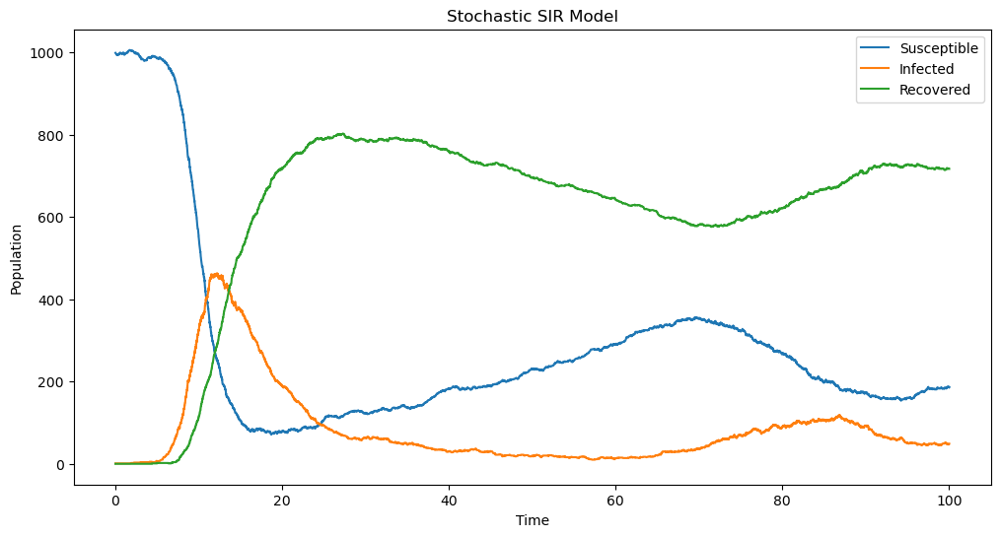

In [41]:
# Defining the parameters
beta = 1  # infection rate
gamma = 1/5  # recovery rate
mu = 1/60  # birth and death rate
N = 1000  # total population

# Initial conditions
S0 = 999
I0 = 1
R0 = 0
t = 100 # duration

initial_conditions = [S0, I0, R0]

propensities = [lambda s, i, r: beta * s * i / N, # infection 
                        lambda s, i, r: gamma * i,   # recovery
                        lambda s, i, r: mu*N  ,   # birth
                        lambda s, i, r: mu * s,  # death from susceptible group
                        lambda s, i, r: mu * i ,  # death from infected group
                        lambda s, i, r: mu * r]  # death from recovered group

stoichiometry = [[-1, 1, 0],  # infection; Population change: S-1, I+1, R+0
                            [0, -1, 1],  # Recovery; Population change: S+0, I-1, R+1
                            [1, 0, 0],   # Birth: Population change: S+1, I+0, R+0 
                            [-1, 0, 0],  # Death in S; Population change: S-1, I+0, R+0
                            [0, -1, 0],  # Death in I; Population change: S+0, I-1, R+0
                            [0, 0, -1]] # Death in R; Population change: S+0, I+0, R-1

# Running the simulation
time, result = gillespie(initial_conditions, propensities, stoichiometry, t)
S, I, R = zip(*result)

# Plotting the results
plt.figure(figsize=(12, 6))
plt.plot(time, S, label='Susceptible')
plt.plot(time, I, label='Infected')
plt.plot(time, R, label='Recovered')
plt.xlabel('Time')
plt.ylabel('Population')
plt.title('Stochastic SIR Model')
plt.legend()
plt.show()

Comparing with a deterministic ODE model:

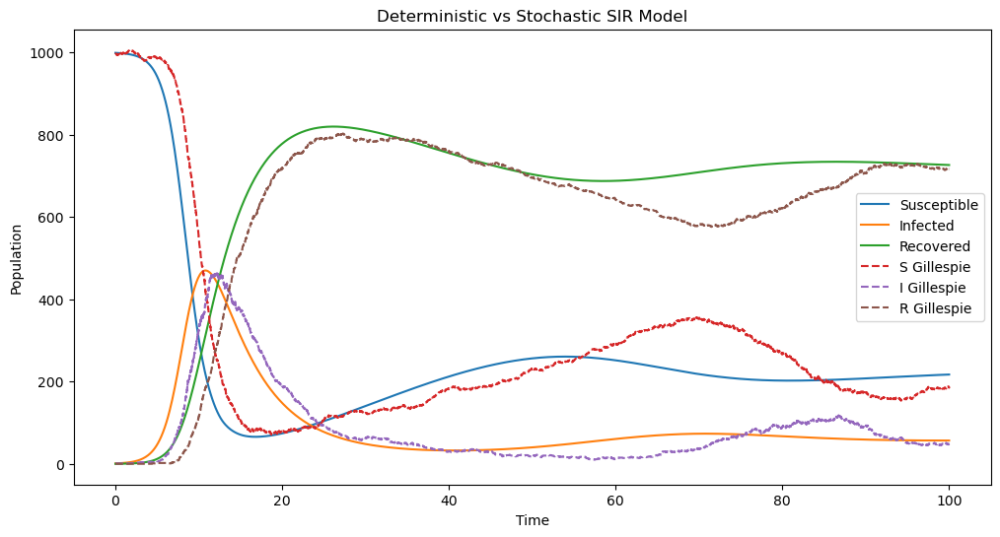

In [42]:
def sir_model(t, y, beta, gamma, mu):
    S, I, R = y
    dSdt = mu*N  - beta * S * I/N  - mu * S
    dIdt = beta * S * I/N - gamma * I - mu * I
    dRdt = gamma * I- mu * R
    return [dSdt, dIdt, dRdt]

sol = solve_ivp(sir_model, [0, t], initial_conditions, args=(beta, gamma, mu), t_eval=np.linspace(0, t, 1000))
S_d, I_d, R_d = sol.y

# Plotting the results
plt.figure(figsize=(12, 6))
plt.plot(sol.t, S_d, label='Susceptible')
plt.plot(sol.t, I_d , label='Infected')
plt.plot(sol.t, R_d, label='Recovered')

plt.plot(time, S, linestyle = "--", label='S Gillespie')
plt.plot(time, I, linestyle = "--", label='I Gillespie')
plt.plot(time, R, linestyle = "--", label='R Gillespie')
plt.xlabel('Time')
plt.ylabel('Population')
plt.title('Deterministic vs Stochastic SIR Model')
plt.legend()
plt.show()

### Investigate Simulation Variability and Negative Co-variance

In [43]:
#function to run the simulation multiple times
def multiple_runs(params, num_runs, t_max):
    beta, gamma, mu = params
    # Initializing the lists to store the results
    S_mean = []
    I_mean = []
    S_var = []
    I_var = []
    S_I_cov = []

    for i in range(num_runs):
        # Running the simulation
        time, result = gillespie(initial_conditions, propensities, stoichiometry, t_max)
        S, I, R = zip(*result)
        # Storing the mean and variance of S and I
        S_mean.append(np.mean(S))
        I_mean.append(np.mean(I))
        S_var.append(np.var(S))
        I_var.append(np.var(I))
        S_I_cov.append(np.cov(S, I)[0, 1])

    # Calculating the average of the mean and variance
    S_mean_avg = np.mean(S_mean, axis=0)
    I_mean_avg = np.mean(I_mean, axis=0)
    S_variance = np.var(S_var, axis=0)
    I_variance = np.var(I_var, axis=0)
    Cov = np.mean(S_I_cov, axis=0)

    return [S_mean_avg, I_mean_avg, S_variance, I_variance, Cov]

Let's analyse how varying the model parameters changes the behaviour of the stochastic dynamics. First, we will keep all parameters constant except $\beta$, the infection rate, then we will vary the recovery rate, birth/death rate and finally the population size.

#### Varying infection rate $\beta$

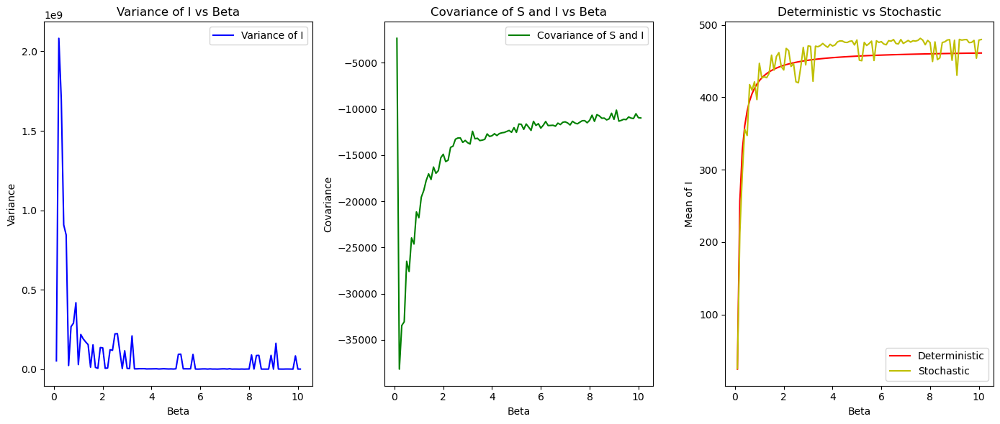

In [44]:
beta = 0
gamma = 1/30
mu = 1/60
params = [beta, gamma, mu]
num_runs = 20
t_max = 100

varI_beta = []
cov_beta = []
beta_list = []
mean_beta_deterministic = []
mean_beta_stochastic = []

while beta < 10:
    beta += 0.1
    params[0] = beta
    beta_list.append(beta)
    S_mean, I_mean, S_var, I_var, cov = multiple_runs(params, num_runs, t_max)
    varI_beta.append(S_var)
    cov_beta.append(cov)
    sol = solve_ivp(sir_model, [0, t_max], initial_conditions, args=(beta, gamma, mu), t_eval=np.linspace(0, t_max, 1000))
    S_d, I_d, R_d = sol.y
    mean_beta_deterministic.append(np.mean(I_d))
    mean_beta_stochastic.append(I_mean)

    

# Create a figure with two subplots (1 row, 3 columns)
fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(14, 6))

# First plot: Variance of I vs Beta
ax1.plot(beta_list, varI_beta, label='Variance of I', color='b')
ax1.set_xlabel('Beta')
ax1.set_ylabel('Variance')
ax1.set_title('Variance of I vs Beta')
ax1.legend()

# Second plot: Covariance of S and I vs Beta
ax2.plot(beta_list, cov_beta, label='Covariance of S and I', color='g')
ax2.set_xlabel('Beta')
ax2.set_ylabel('Covariance')
ax2.set_title('Covariance of S and I vs Beta')
ax2.legend()

# Third plot: Comparison of deterministic and stochastic models
ax3.plot(beta_list, mean_beta_deterministic, label='Deterministic', color='r')
ax3.plot(beta_list, mean_beta_stochastic, label='Stochastic', color='y')
ax3.set_xlabel('Beta')
ax3.set_ylabel('Mean of I')
ax3.set_title('Deterministic vs Stochastic')
ax3.legend()

# Adjust layout to prevent overlap
fig.tight_layout()
plt.show()

#### Varying recovery rate $\gamma$

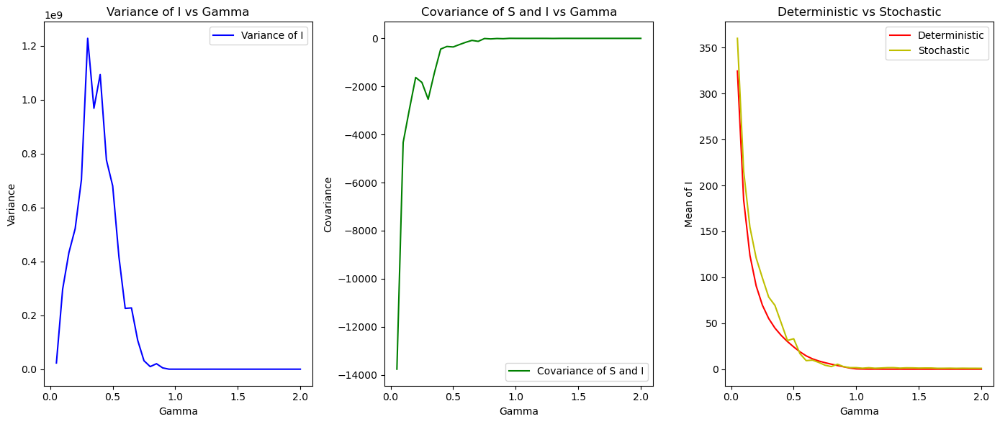

In [45]:
beta = 1
gamma = 0
mu = 1/60
params = [beta, gamma, mu]
num_runs = 20
t_max = 100

varI_gamma = []
cov_gamma = []
gamma_list = []
mean_gamma_deterministic = []
mean_gamma_stochastic = []

while gamma < 2:
    gamma += 0.05
    params[1] = gamma
    gamma_list.append(gamma)
    S_mean, I_mean, S_var, I_var, cov = multiple_runs(params, num_runs, t_max)
    varI_gamma.append(S_var)
    cov_gamma.append(cov)
    sol = solve_ivp(sir_model, [0, t_max], initial_conditions, args=(beta, gamma, mu), t_eval=np.linspace(0, t_max, 1000))
    S_d, I_d, R_d = sol.y
    mean_gamma_deterministic.append(np.mean(I_d))
    mean_gamma_stochastic.append(I_mean)

# Create a figure with two subplots (1 row, 3 columns)
fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(14, 6))

# First plot: Variance of I vs Gamma
ax1.plot(gamma_list, varI_gamma, label='Variance of I', color='b')
ax1.set_xlabel('Gamma')
ax1.set_ylabel('Variance')
ax1.set_title('Variance of I vs Gamma')
ax1.legend()

# Second plot: Covariance of S and I vs Gamma
ax2.plot(gamma_list, cov_gamma, label='Covariance of S and I', color='g')
ax2.set_xlabel('Gamma')
ax2.set_ylabel('Covariance')
ax2.set_title('Covariance of S and I vs Gamma')
ax2.legend()

# Third plot: Comparison of deterministic and stochastic models
ax3.plot(gamma_list, mean_gamma_deterministic, label='Deterministic', color='r')
ax3.plot(gamma_list, mean_gamma_stochastic, label='Stochastic', color='y')
ax3.set_xlabel('Gamma')
ax3.set_ylabel('Mean of I')
ax3.set_title('Deterministic vs Stochastic')
ax3.legend()

# Adjust layout to prevent overlap
fig.tight_layout()
plt.show()

#### Varying birth/death rate $\mu$

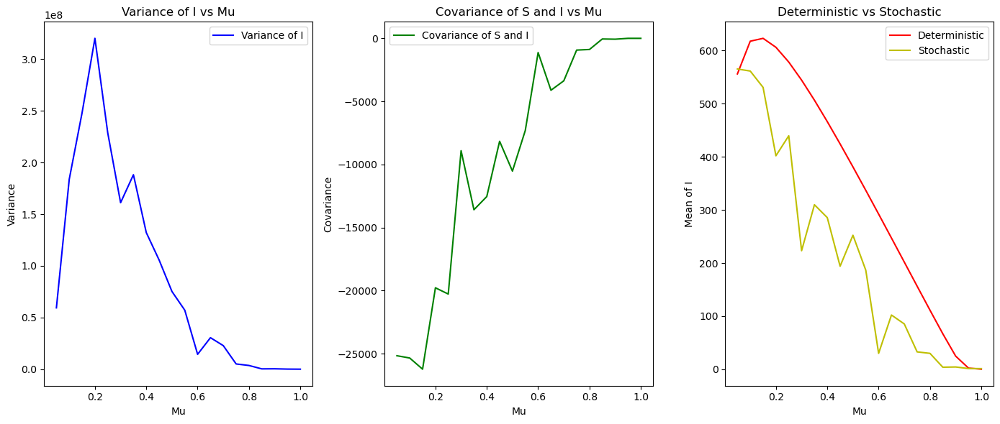

In [46]:
beta = 1
gamma = 1/30
mu = 0
params = [beta, gamma, mu]

num_runs = 20
t_max = 100

varI_mu = []
cov_mu = []
mu_list = []
mean_mu_deterministic = []
mean_mu_stochastic = []

while mu < 1:
    mu += 0.05
    params[2] = mu
    mu_list.append(mu)
    S_mean, I_mean, S_var, I_var, cov = multiple_runs(params, num_runs, t_max)
    varI_mu.append(S_var)
    cov_mu.append(cov)
    sol = solve_ivp(sir_model, [0, t_max], initial_conditions, args=(beta, gamma, mu), t_eval=np.linspace(0, t_max, 1000))
    S_d, I_d, R_d = sol.y
    mean_mu_deterministic.append(np.mean(I_d))
    mean_mu_stochastic.append(I_mean)

# Create a figure with two subplots (1 row, 3 columns)
fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(14, 6))

# First plot: Variance of I vs Mu
ax1.plot(mu_list, varI_mu, label='Variance of I', color='b')
ax1.set_xlabel('Mu')
ax1.set_ylabel('Variance')
ax1.set_title('Variance of I vs Mu')
ax1.legend()

# Second plot: Covariance of S and I vs Mu
ax2.plot(mu_list, cov_mu, label='Covariance of S and I', color='g')
ax2.set_xlabel('Mu')
ax2.set_ylabel('Covariance')
ax2.set_title('Covariance of S and I vs Mu')
ax2.legend()

# Third plot: Comparison of deterministic and stochastic models
ax3.plot(mu_list, mean_mu_deterministic, label='Deterministic', color='r')
ax3.plot(mu_list, mean_mu_stochastic, label='Stochastic', color='y')
ax3.set_xlabel('Mu')
ax3.set_ylabel('Mean of I')
ax3.set_title('Deterministic vs Stochastic')
ax3.legend()

# Adjust layout to prevent overlap
fig.tight_layout()
plt.show()
    

#### Varying population size $N$

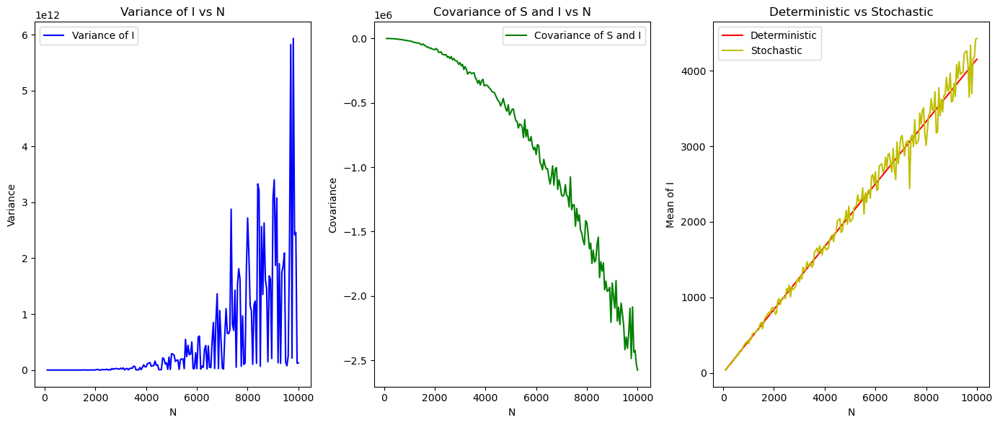

In [47]:
beta = 1
gamma = 1/30
mu = 1/60
params = [beta, gamma, mu]
N = 50

num_runs = 20
t_max = 100

varI_N = []
cov_N = []
N_list = []
mean_N_deterministic = []
mean_N_stochastic = []

while N < 10000:
    N += 50
    S0 = N - 1
    I0 = 1
    R0 = 0
    initial_conditions = [S0, I0, R0]
    N_list.append(N)
    S_mean, I_mean, S_var, I_var, cov = multiple_runs(params, num_runs, t_max)
    varI_N.append(S_var)
    cov_N.append(cov)
    sol = solve_ivp(sir_model, [0, t_max], initial_conditions, args=(beta, gamma, mu), t_eval=np.linspace(0, t_max, 1000))
    S_d, I_d, R_d = sol.y
    mean_N_deterministic.append(np.mean(I_d))
    mean_N_stochastic.append(I_mean)

# Create a figure with two subplots (1 row, 3 columns)
fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(14, 6))

# First plot: Variance of I vs N
ax1.plot(N_list, varI_N, label='Variance of I', color='b')
ax1.set_xlabel('N')
ax1.set_ylabel('Variance')
ax1.set_title('Variance of I vs N')
ax1.legend()

# Second plot: Covariance of S and I vs N
ax2.plot(N_list, cov_N, label='Covariance of S and I', color='g')
ax2.set_xlabel('N')
ax2.set_ylabel('Covariance')
ax2.set_title('Covariance of S and I vs N')
ax2.legend()

# Third plot: Comparison of deterministic and stochastic models
ax3.plot(N_list, mean_N_deterministic, label='Deterministic', color='r')
ax3.plot(N_list, mean_N_stochastic, label='Stochastic', color='y')
ax3.set_xlabel('N')
ax3.set_ylabel('Mean of I')
ax3.set_title('Deterministic vs Stochastic')
ax3.legend()

# Adjust layout to prevent overlap
fig.tight_layout()
plt.show()

### Stochastic Resonance and Increased Transients

We first simulated the deterministic SIR model as a baseline, where population dynamics settle into equilibrium through decaying outbreaks. Then, we ran multiple stochastic SIR simulations to observe fluctuations caused by random noise, which can induce oscillations, absent in the deterministic model. To compare, we plotted the phase trajectories of the susceptible and infected populations for both models. We then used the Euclidean distance between the mean infections in the stochastic and deterministic models to measure deviations. By varying the disease parameters $\beta, \gamma, \mu, N$, we identified how they influenced the distance between the stochastic and deterministic models.

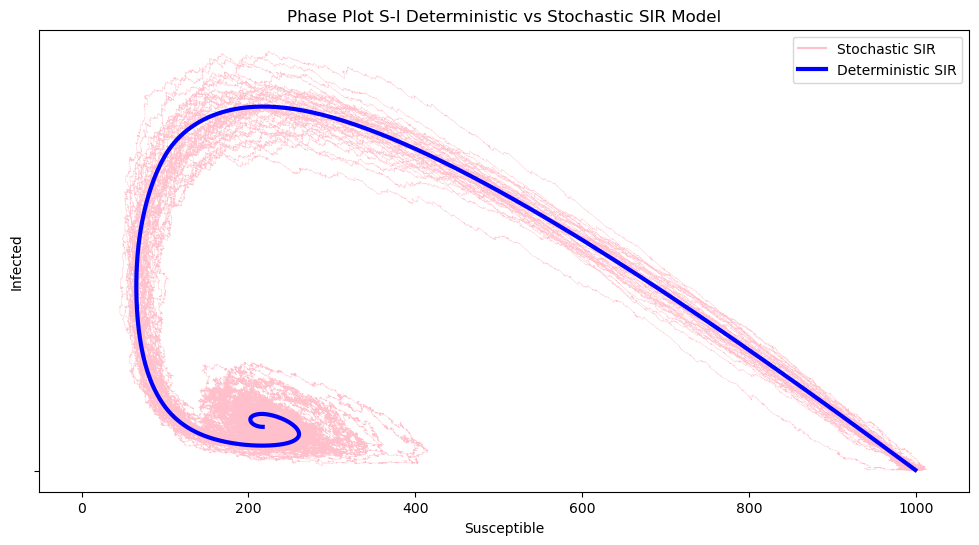

In [48]:

beta = 1
gamma = 1/5
mu = 1/60
N = 1000

S0 = 999
I0 = 1
R0 = 0
t = 100 # duration

initial_conditions = [S0, I0, R0]

sol = solve_ivp(sir_model, [0, t], initial_conditions, args=(beta, gamma, mu), t_eval=np.linspace(0, t, 1000))
S_d, I_d, R_d = sol.y

S_list, I_list, R_list = [], [], []
num_runs = 50
for i in range(num_runs):
    time, result = gillespie(initial_conditions, propensities, stoichiometry, t)
    S, I, R = zip(*result)
    S_list.append(S)
    I_list.append(I)
    R_list.append(R)



# Plotting the results
plt.figure(figsize=(12, 6))

for i in range(num_runs):
    plt.plot(S_list[i], I_list[i], color='pink', linewidth=0.3)
plt.plot('', '', color='pink', label='Stochastic SIR')
plt.plot(S_d, I_d, label='Deterministic SIR', color='blue', linewidth=3)
plt.xlabel('Susceptible')
plt.ylabel('Infected')
plt.title('Phase Plot S-I Deterministic vs Stochastic SIR Model')
plt.legend()
plt.show()



#### Varying infection rate $\beta$

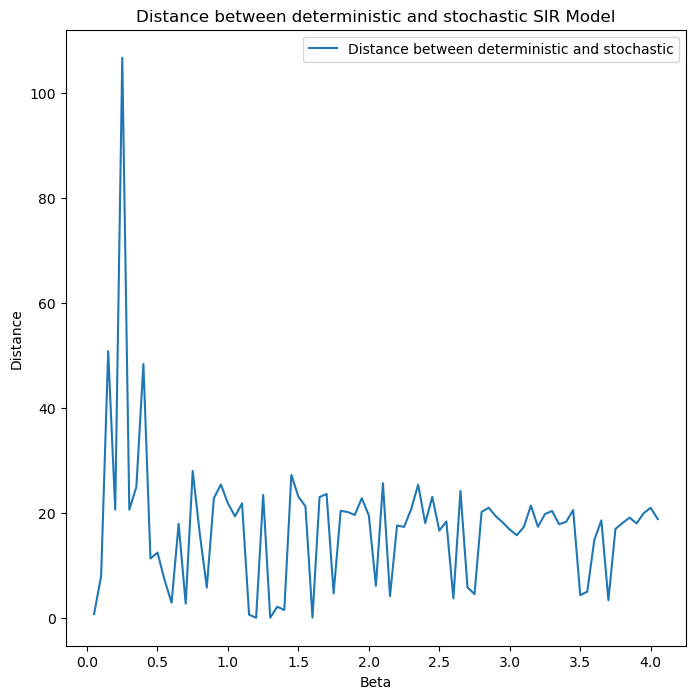

In [49]:
beta = 0
gamma = 1/30
mu = 1/60
params = [beta, gamma, mu]
num_runs = 20
t_max = 100

beta_list = []
distance_list = []

while beta < 4:
    beta += 0.05
    params[0] = beta
    beta_list.append(beta)
    S_mean, I_mean, S_var, I_var, cov = multiple_runs(params, num_runs, t_max)
    sol = solve_ivp(sir_model, [0, t_max], initial_conditions, args=(beta, gamma, mu), t_eval=np.linspace(0, t_max, 1000))
    time, result = gillespie(initial_conditions, propensities, stoichiometry, t)
    S, I, R = zip(*result)
    S_d, I_d, R_d = sol.y

    #calculate euclidean distance between the mean of the stochastic and the deterministic
    dist = abs(np.mean(I_d) - I_mean)
    distance_list.append(dist)
    

plt.figure(figsize=(8, 8))
plt.plot(beta_list, distance_list, label='Distance between deterministic and stochastic')
plt.xlabel('Beta')
plt.ylabel('Distance')
plt.title('Distance between deterministic and stochastic SIR Model')
plt.legend()
plt.show()

#### Varying recovery rate $\gamma$

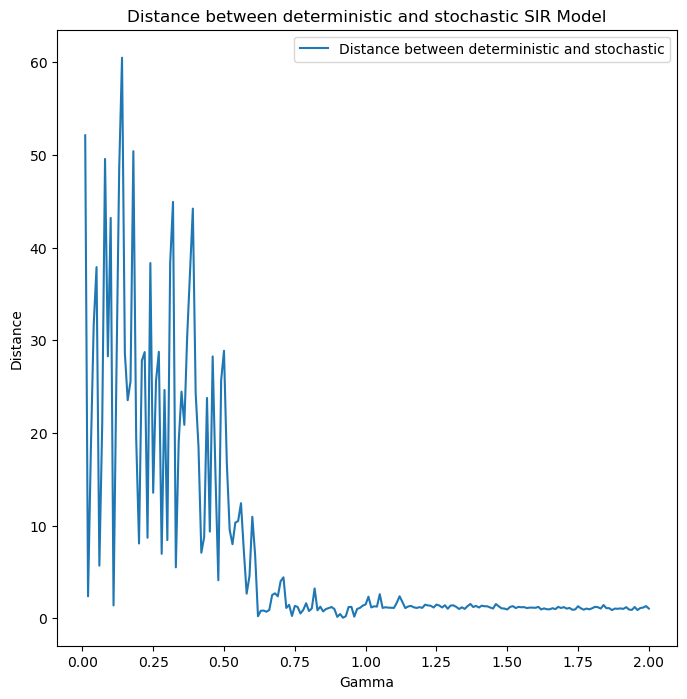

In [50]:
beta = 1
gamma = 0
mu = 1/60
params = [beta, gamma, mu]
num_runs = 20
t_max = 100

gamma_list = []
distance_list = []

while gamma < 2:
    gamma += 0.01
    params[1] = gamma
    gamma_list.append(gamma)
    S_mean, I_mean, S_var, I_var, cov = multiple_runs(params, num_runs, t_max)
    sol = solve_ivp(sir_model, [0, t_max], initial_conditions, args=(beta, gamma, mu), t_eval=np.linspace(0, t_max, 1000))
    time, result = gillespie(initial_conditions, propensities, stoichiometry, t)
    S, I, R = zip(*result)
    S_d, I_d, R_d = sol.y

    #calculate euclidean distance between the mean of the stochastic and the deterministic
    dist = abs(np.mean(I_d) - I_mean)
    distance_list.append(dist)
    

plt.figure(figsize=(8, 8))
plt.plot(gamma_list, distance_list, label='Distance between deterministic and stochastic')
plt.xlabel('Gamma')
plt.ylabel('Distance')
plt.title('Distance between deterministic and stochastic SIR Model')
plt.legend()
plt.show()

#### Varying birth/death rate $\mu$

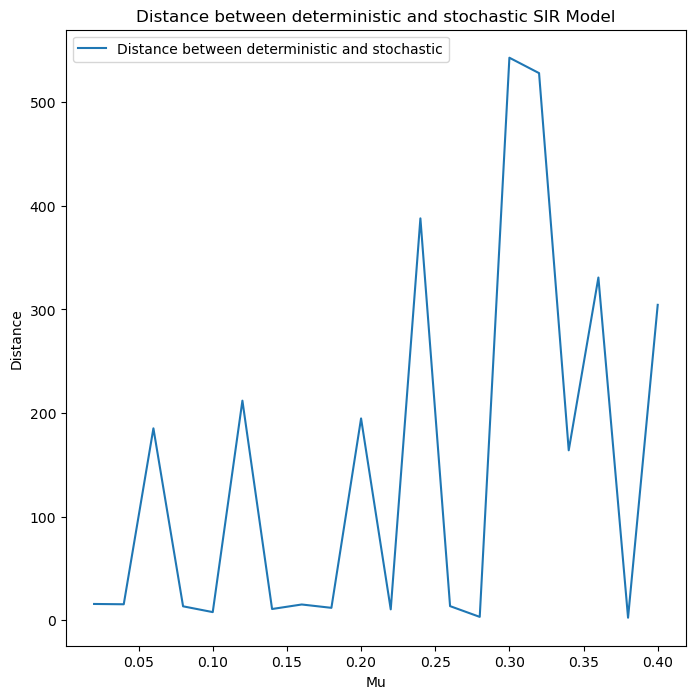

In [51]:
beta = 1
gamma = 1/30
mu = 0
params = [beta, gamma, mu]
num_runs = 3
t_max = 100

mu_list = []
distance_list = []

while mu < 0.4:
    mu += 0.02
    params[2] = mu
    mu_list.append(mu)
    S_mean, I_mean, S_var, I_var, cov = multiple_runs(params, num_runs, t_max)
    sol = solve_ivp(sir_model, [0, t_max], initial_conditions, args=(beta, gamma, mu), t_eval=np.linspace(0, t_max, 1000))
    time, result = gillespie(initial_conditions, propensities, stoichiometry, t)
    S, I, R = zip(*result)
    S_d, I_d, R_d = sol.y

    #calculate euclidean distance between the mean of the stochastic and the deterministic
    dist = abs(np.mean(I_d) - I_mean)
    distance_list.append(dist)
    

plt.figure(figsize=(8, 8))
plt.plot(mu_list, distance_list, label='Distance between deterministic and stochastic')
plt.xlabel('Mu')
plt.ylabel('Distance')
plt.title('Distance between deterministic and stochastic SIR Model')
plt.legend()
plt.show()

#### Varying population size N

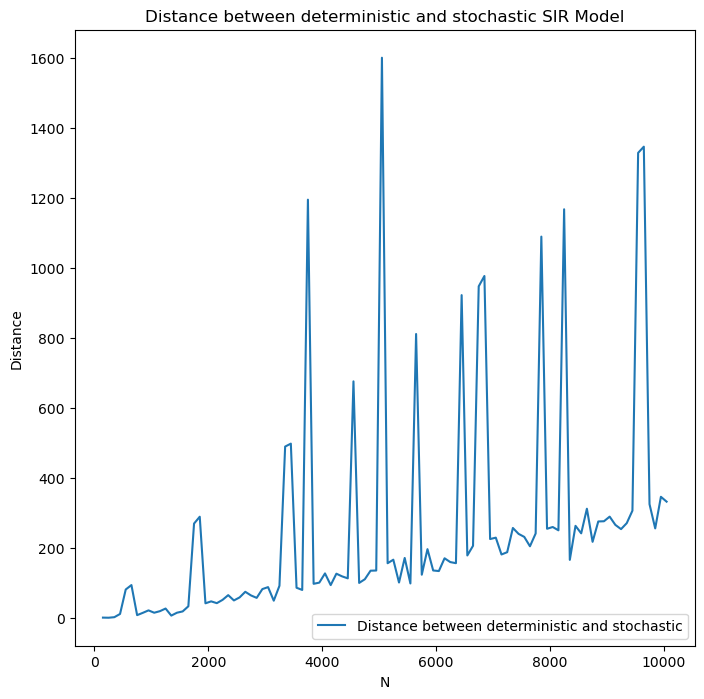

In [52]:
beta = 1
gamma = 1/30
mu = 1/60
params = [beta, gamma, mu]
num_runs = 3
t_max = 50

N_list = []
distance_list = []
N=50

while N < 10000:
    N += 100
    S0 = N - 1
    I0 = 1
    R0 = 0
    initial_conditions = [S0, I0, R0]
    N_list.append(N)
    S_mean, I_mean, S_var, I_var, cov = multiple_runs(params, num_runs, t_max)
    sol = solve_ivp(sir_model, [0, t_max], initial_conditions, args=(beta, gamma, mu), t_eval=np.linspace(0, t_max, 1000))
    time, result = gillespie(initial_conditions, propensities, stoichiometry, t)
    S, I, R = zip(*result)
    S_d, I_d, R_d = sol.y

    #calculate euclidean distance between the mean of the stochastic and the deterministic
    dist = abs(np.mean(I_d) - I_mean)
    distance_list.append(dist)
    

plt.figure(figsize=(8, 8))
plt.plot(N_list, distance_list, label='Distance between deterministic and stochastic')
plt.xlabel('N')
plt.ylabel('Distance')
plt.title('Distance between deterministic and stochastic SIR Model')
plt.legend()
plt.show()

### Extinction events and Critical Community Size

In this implementation, we design an experiment to explore how varying the basic reproduction number $R_0$ and population size N affect the extinction of a virus, even when $R_0 > 1$, in a closed population. Using the Gillespie algorithm for stochastic simulation, we run multiple simulations for each combination of $R_0$ and N, tracking the number of extinction events. For each simulation, we initialize the susceptible, infected, and recovered  individuals, and check whether the infection dies out over time. The results are organized in a table showing how the extinction frequency changes based on $R_0$ and N, allowing for analysis of the interaction between these two parameters and their impact on virus extinction.

In [53]:
# Initialising the parameters
beta = 1  # infection rate
gamma = 1/5  # recovery rate
mu = 1/60  # birth and death rate
N = 1000  # total population

# Initial conditions
S0 = 999
I0 = 1
R0 = 0
t = 1000 # duration

initial_conditions = [S0, I0, R0]

R0_list = [0.5, 1, 2, 3, 4, 5, 6, 7, 8]
N_list = [100, 250 ,400, 500, 1000, 5000, 10000, 20000]
num_simulations = 10

extinction_dict = {}
for R_0 in R0_list:
    extinction_dict[R_0] = {}
    beta = R_0 * (gamma +mu)
    params = [beta, gamma, mu]
    for N in N_list:
        extinction_dict[R_0][N] = {}    
        extinction_dict[R_0][N] = 0
        S0 = N - 1
        I0 = 1
        R0 = 0
        initial_conditions = [S0, I0, R0]
        for i in range(num_simulations):
            # Running the simulation
            time, result = gillespie(initial_conditions, propensities, stoichiometry, t)
            S, I, R = zip(*result)
            if I[-1] == 0: #check for extinction
                extinction_dict[R_0][N] += 1

# Generate HTML table manually
html_table = '<table style="border-collapse: collapse; width: 100%; font-size: 18px;">'
html_table += '<tr><th colspan="1" style="border: 1px solid black; padding: 10px; text-align: center;">R0 / N</th>'

# Create header row with N values
for N in N_list:
    html_table += f'<th style="border: 1px solid black; padding: 10px; text-align: center;">{N}</th>'
html_table += '</tr>'

# Populate the table rows
for r0 in R0_list:
    html_table += f'<tr><td style="border: 1px solid black; padding: 10px;">{r0}</td>'
    for N in N_list:
        html_table += f'<td style="border: 1px solid black; padding: 10px; text-align: center;">{extinction_dict[r0][N]}</td>'
    html_table += '</tr>'

html_table += '</table>'

# Display the HTML table
from IPython.core.display import display, HTML
display(HTML(html_table))


/var/folders/lt/3tf47cnj2n5f1w0d_h6xmyvr0000gn/T/ipykernel_67764/2685249663.py:57: DeprecationWarning: Importing display from IPython.core.display is deprecated since IPython 7.14, please import from IPython display
  from IPython.core.display import display, HTML


R0 / N,100,250,400,500,1000,5000,10000,20000
0.5,10,10,10,10,10,10,10,10
1,10,10,10,10,10,10,10,10
2,10,10,10,10,7,5,7,4
3,10,10,9,9,4,3,5,5
4,10,10,9,6,1,2,1,2
5,10,9,5,7,0,2,2,3
6,10,9,4,2,2,1,2,1
7,10,6,3,1,1,1,2,2
8,10,8,1,4,1,1,2,0


## Problem 2: Spatial Models

### Implement SIR and Simulate

We simulate the spread of disease using the SIR model on networks generated by the Erdos-Renyi graph model. We vary key disease parameters, including the infection rate (beta), recovery rate (gamma), and the initial fraction of infected individuals, to observe their impact on disease dynamics. The code runs multiple simulations for different network sizes and connection probabilities, allowing for a comparative analysis of the spread. Visualizations of the simulation trends are generated using Bokeh. <br>
This block of code can take a long time to run so we have added a break command, if you want to run all the possible iterations just comment the line : "flag = True"

In [66]:
import networkx as nx
import ndlib.models.epidemics as ep
import ndlib.models.ModelConfig as mc
from bokeh.io import output_notebook, show
from ndlib.viz.bokeh.DiffusionTrend import DiffusionTrend
import matplotlib.pyplot as plt
import ndlib
from bokeh.layouts import gridplot

#visualize network
def plot_network(models_trends, cols=2):
    # Prepare the plots in Bokeh
    plots = []
    
    for model, trends in models_trends:
        viz = DiffusionTrend(model, trends)
        p = viz.plot(width=400, height=400)  # Adjust plot size
        plots.append(p)

    # Create a grid layout with the plots, 4 per row
    grid = gridplot([plots[i:i + cols] for i in range(0, len(plots), cols)], plot_width=400, plot_height=400)

    # Show the grid of plots
    show(grid)

#run the network
def run_network(beta, gamma, infected, g):
    model = ep.SIRModel(g)
    config = mc.Configuration()
    config.add_model_parameter('beta', beta)
    config.add_model_parameter('gamma', gamma)
    config.add_model_parameter("fraction_infected", infected)
    model.set_initial_status(config)    
    iterations = model.iteration_bunch(400)
    trends = model.build_trends(iterations)
    return trends, model
    

# Network Definition
#g = nx.erdos_renyi_graph(1000, 0.1)

# list of values for the disease parameters
beta_list = [0.0003, 0.0005, 0.001, 0.002]
gamma_list = [0.001, 0.002, 0.005, 0.008]
infected_list = [0.01, 0.05, 0.1, 0.25]

#list of values for network parameters
nodes_list = [1000, 2000, 5000, 10000]
connection_list = [0.05, 0.1, 0.2, 0.3]

output_notebook()
# Simulation
flag = False
for nodes in nodes_list:
    for prob in connection_list:
        g = nx.erdos_renyi_graph(nodes, prob)
        #varying infection rate
        gamma = 0.01
        infected = 0.05
        model_list_beta = []
        for beta in beta_list:
            trends, model = run_network(beta, gamma, infected, g)
            model_list_beta.append((model, trends))
        if nodes == 1000 and prob == 0.1:
            plot_network(model_list_beta)
            flag = True
            break
        #plot_network(model_list_beta)

        #varying recovery rate  
        beta = 0.001
        infected = 0.05
        model_list_gamma = []
        for gamma in gamma_list:
            trends, model = run_network(beta, gamma, infected, g)
            model_list_gamma.append((model, trends))
        #plot_network(model_list_gamma)

        #varying initial infected
        beta = 0.001
        gamma = 0.01
        model_list_infected = []
        for infected in infected_list:
            trends, model = run_network(beta, gamma, infected, g)
            model_list_infected.append((model, trends))
        #plot_network(model_list_infected)
    if flag:
        break





Loading BokehJS ...

100%|██████████| 400/400 [00:01<00:00, 393.41it/s]


### Generate Network of equivalent form

Using NetworkX, we generated Barabási-Albert, Watts-Strogatz, and Erdős-Rényi network models. These models were compared across different disease parameters and network statistics, including degree centrality, closeness centrality, betweenness centrality, eigenvector centrality, clustering coefficient, and degree distribution.

#### Barabasi-Albert Graph

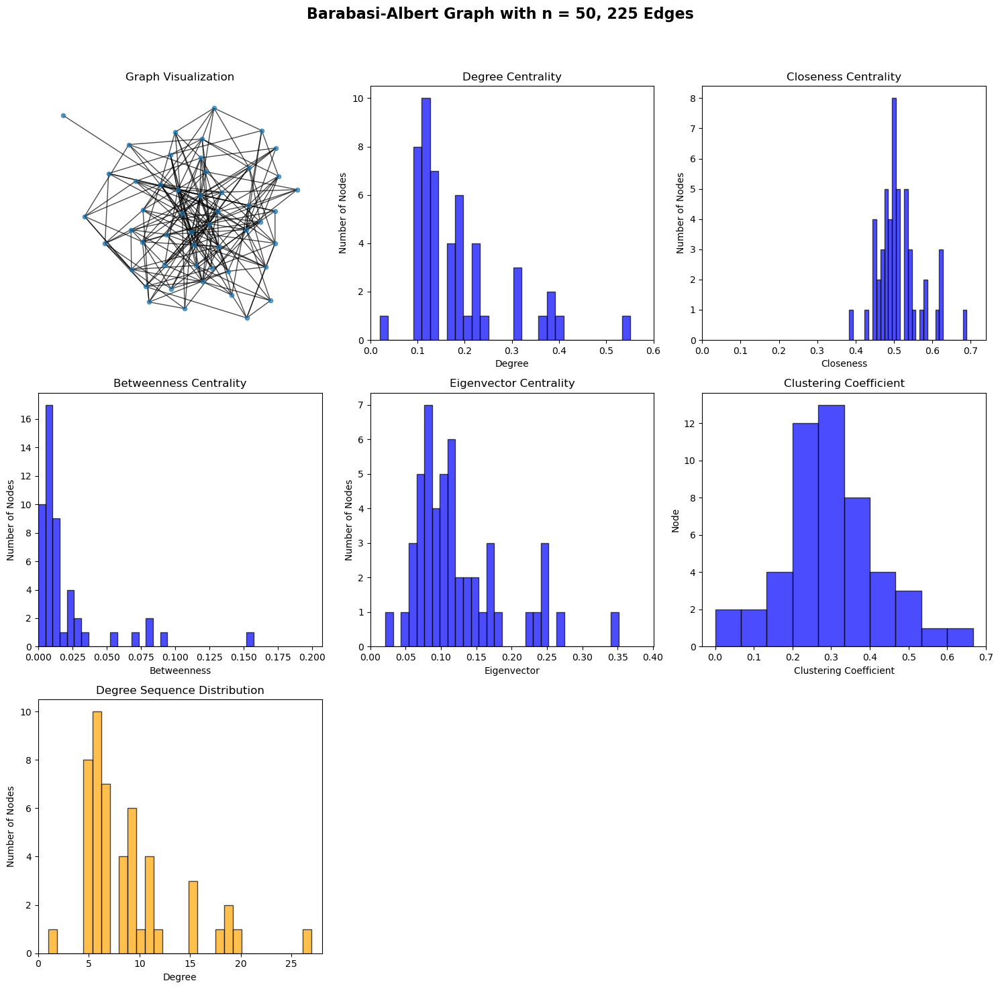

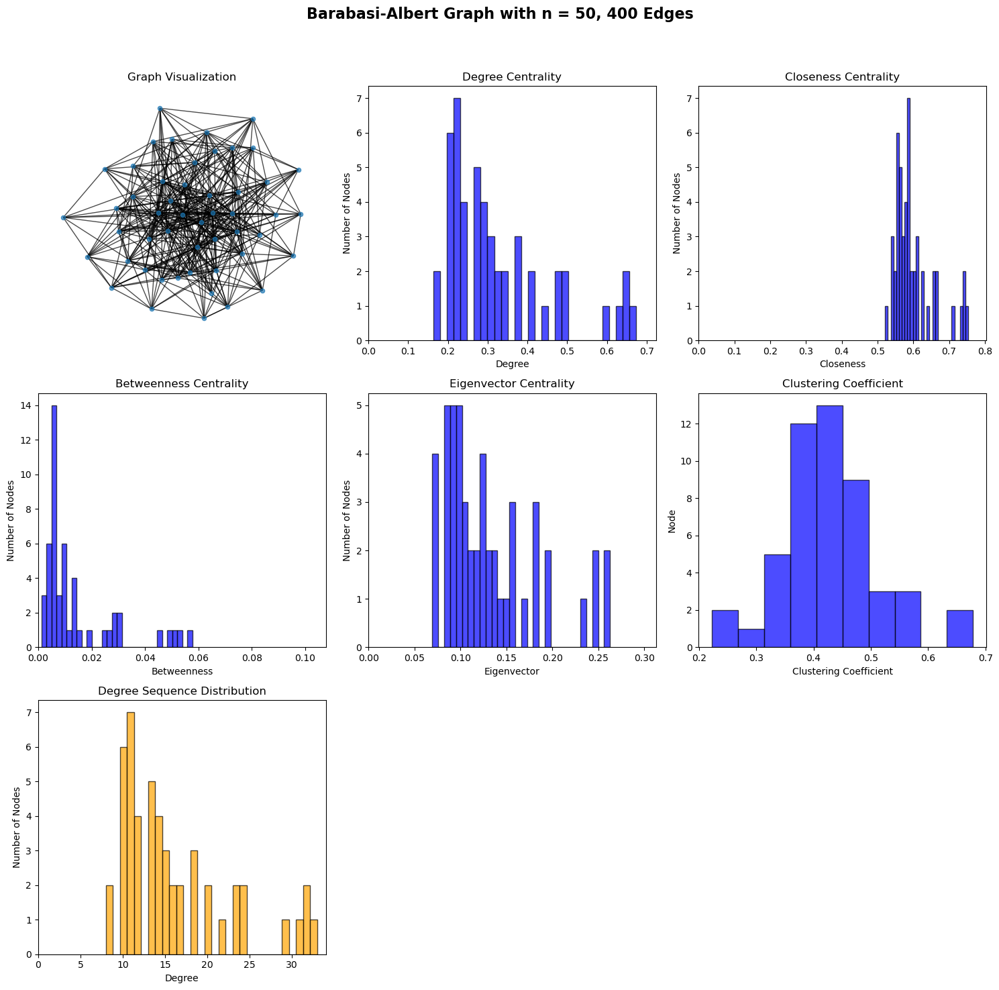

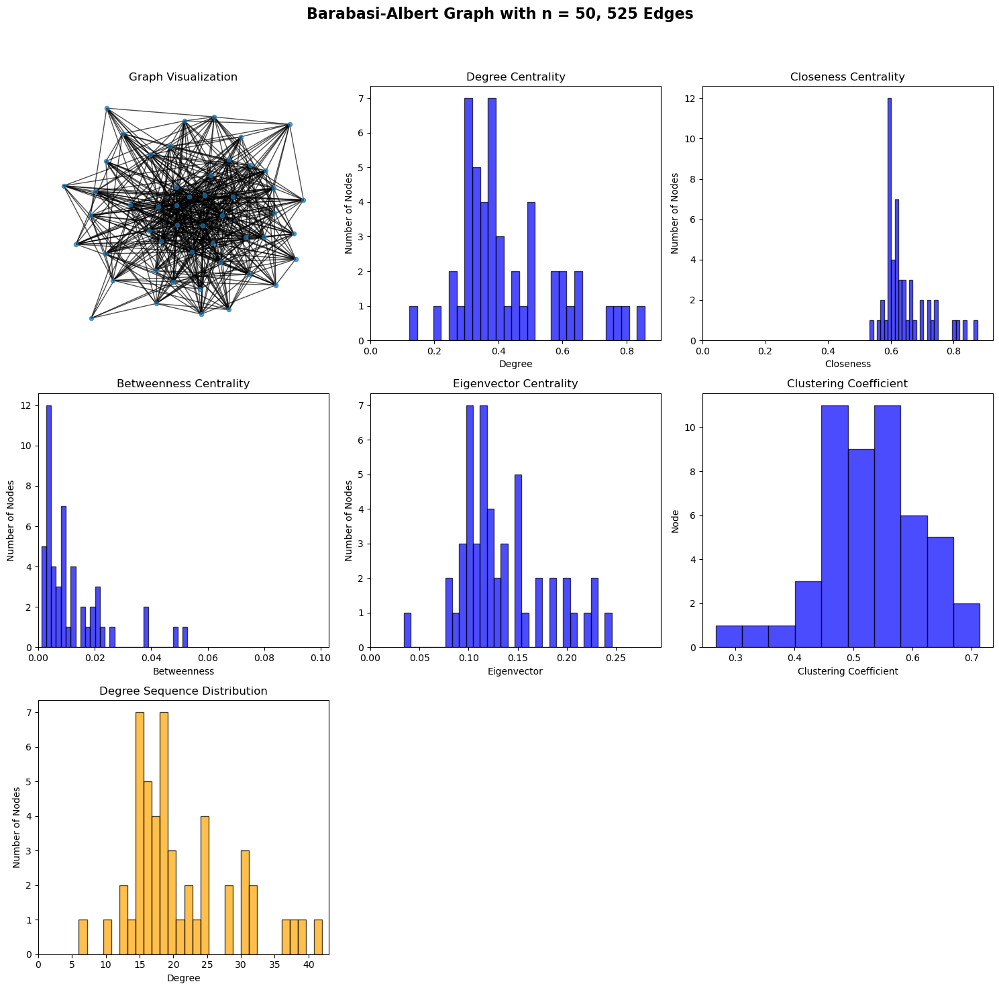

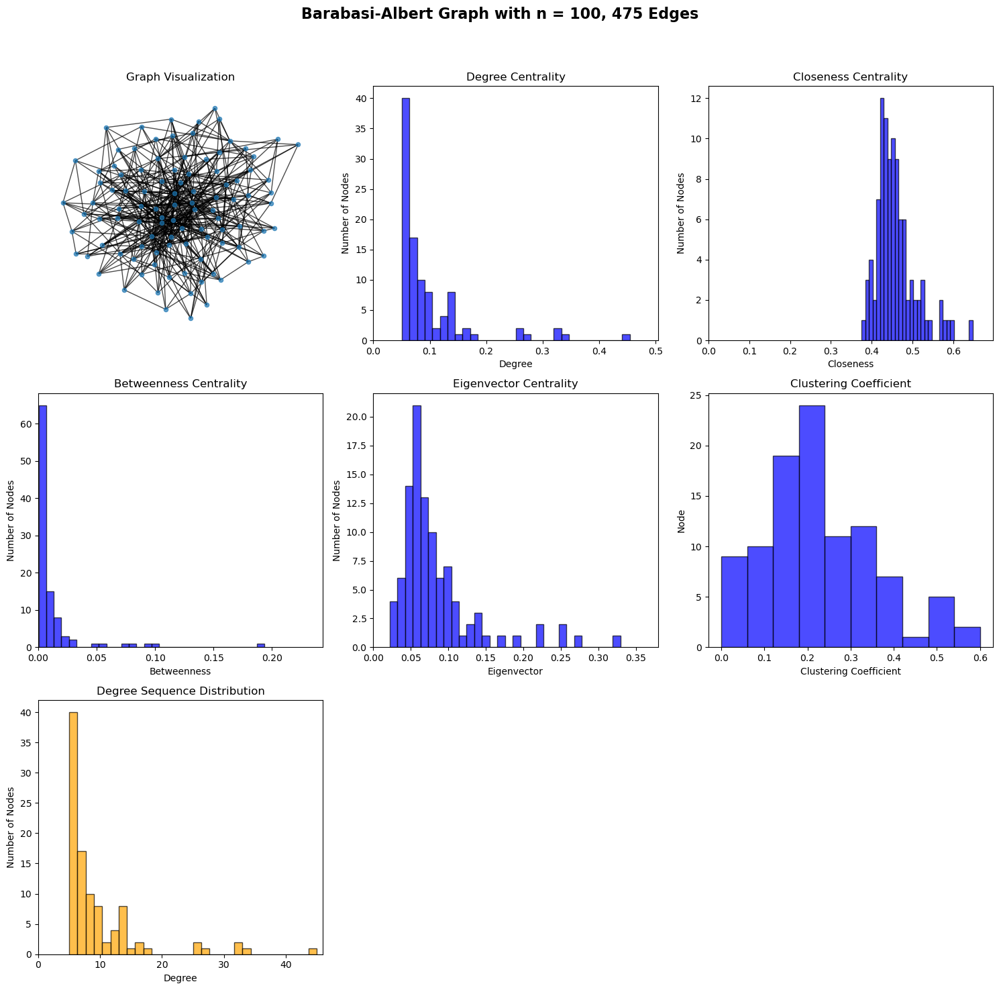

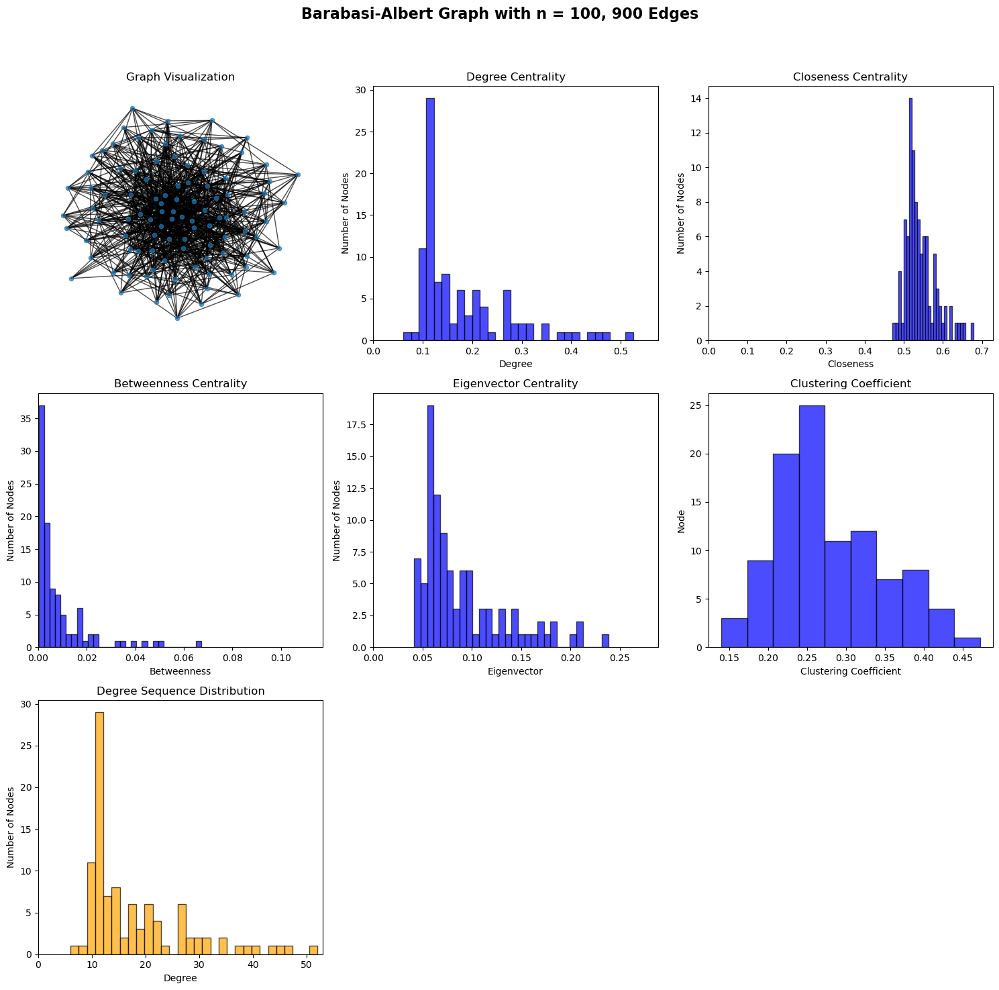

...

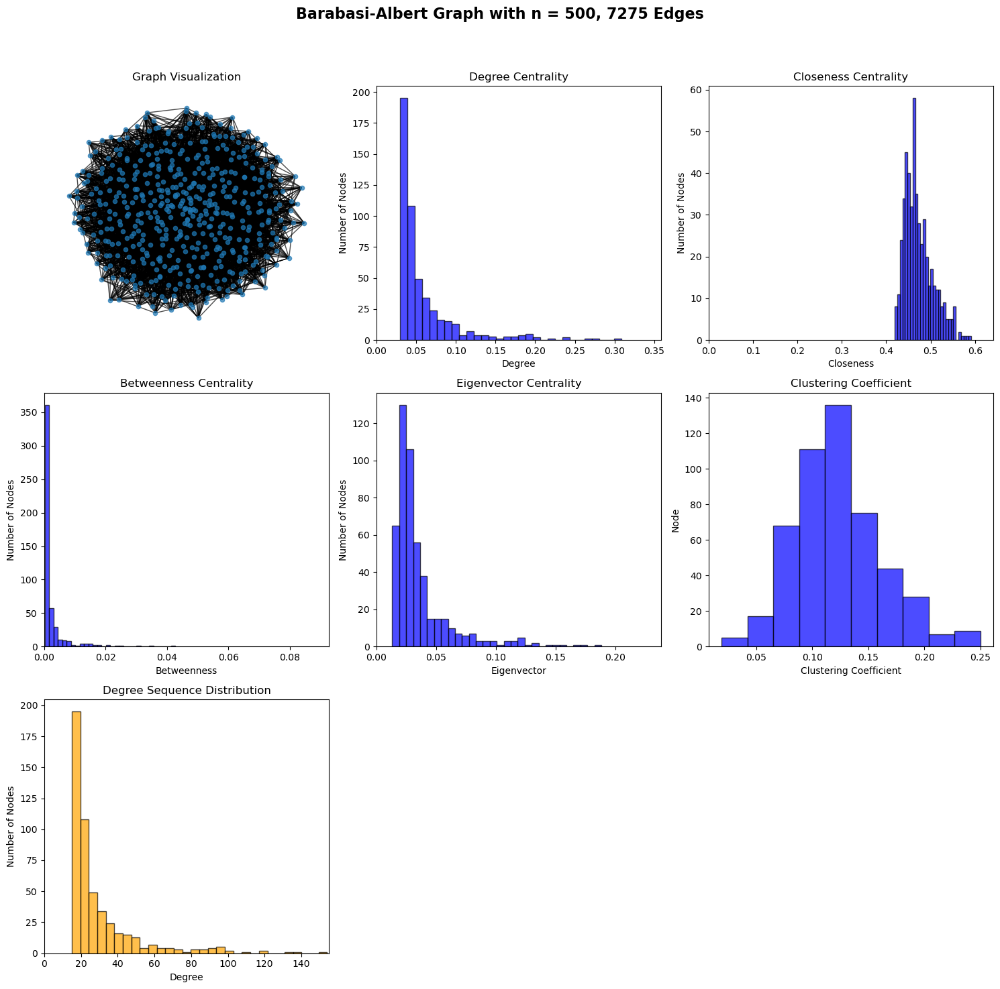

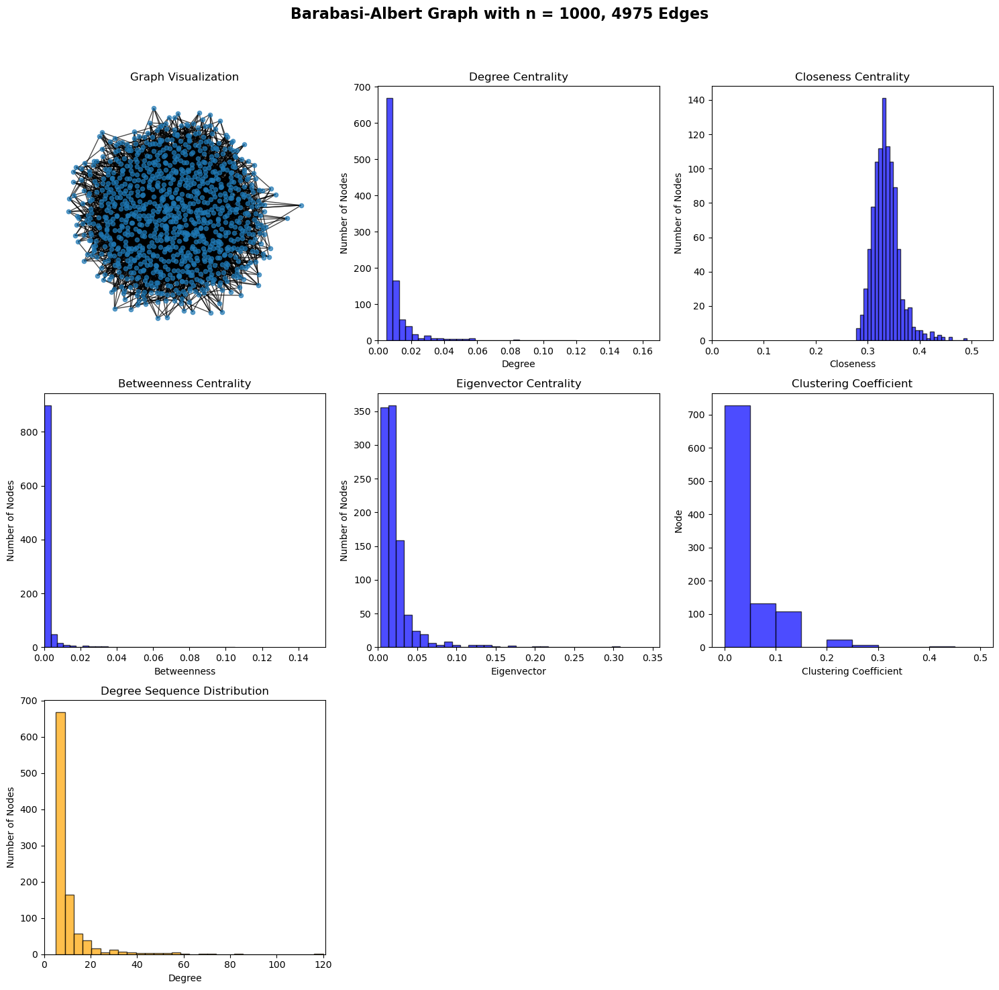

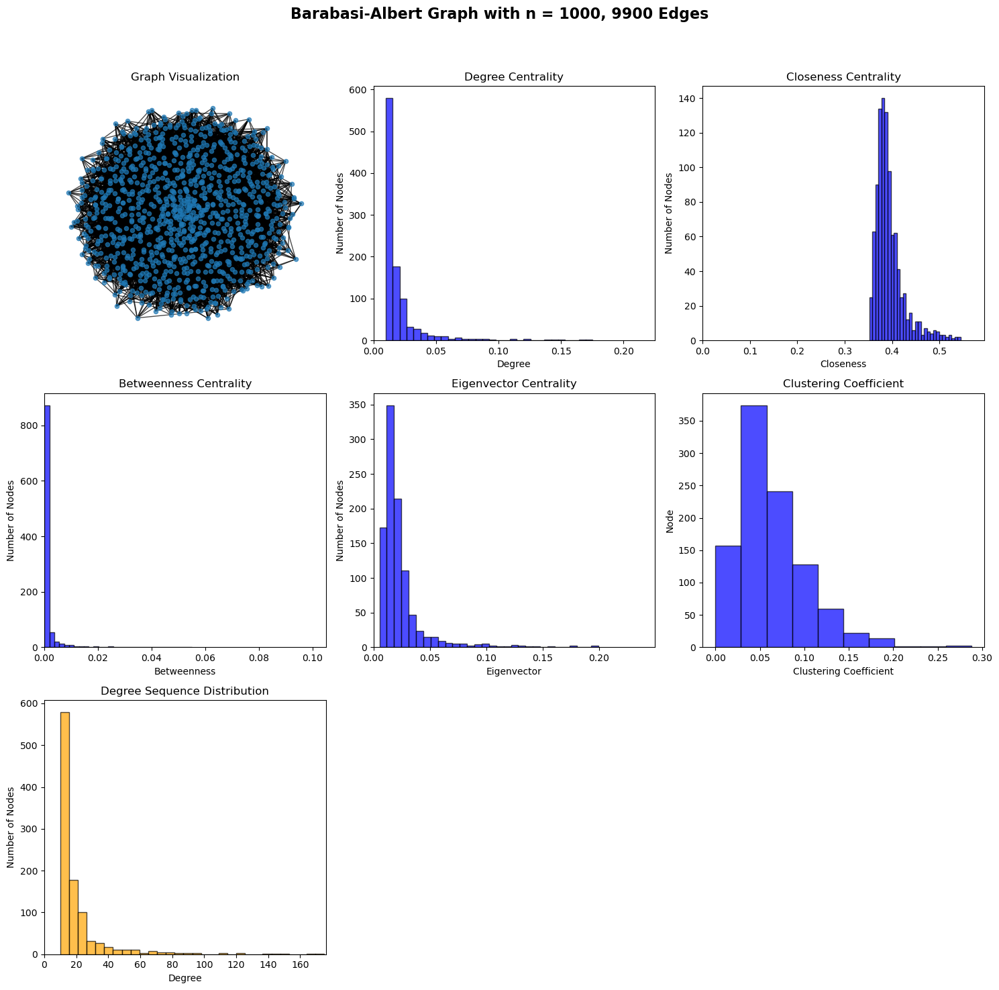

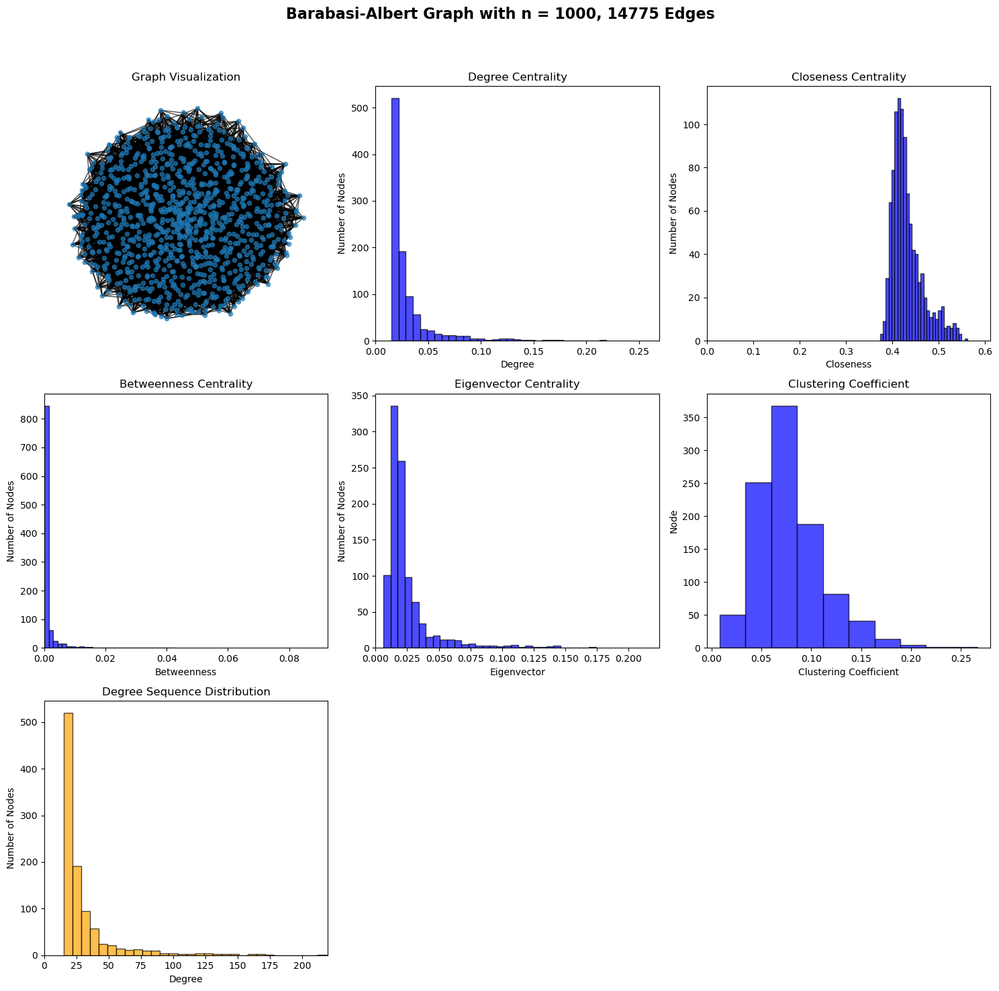

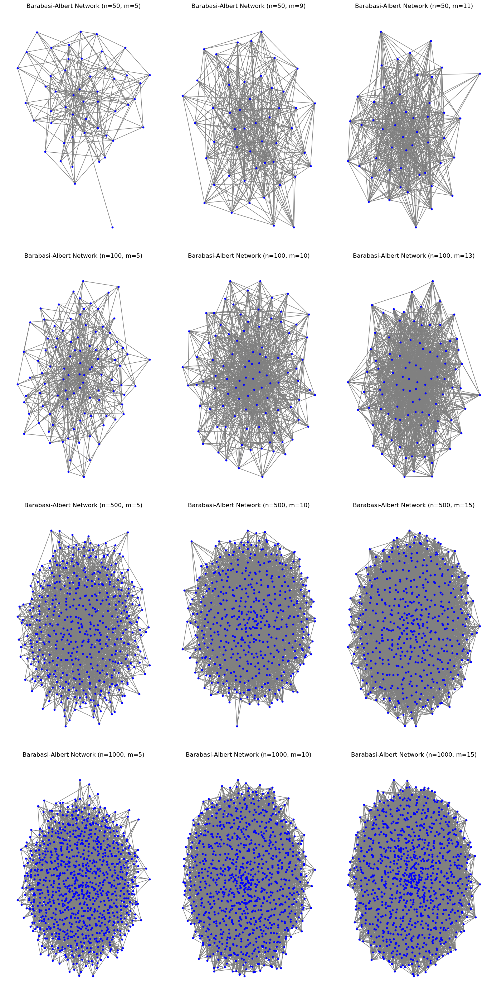

In [55]:
#get statistical measures of g
def statistical_measures(g):
    statistics_dict = {}
    statistics_dict['Degree'] = nx.degree_centrality(g)
    statistics_dict['Closeness'] = nx.closeness_centrality(g)
    statistics_dict['Betweenness'] = nx.betweenness_centrality(g)
    statistics_dict['Eigenvector'] = nx.eigenvector_centrality(g, max_iter=500)
    statistics_dict["Clustering"] = nx.clustering(g)  
    statistics_dict["Degree Sequence"] = sorted([d for n, d in g.degree()], reverse=True)
    return statistics_dict


def plot_statistics(statistics, g, graph_name, p=0):
    # Extract keys and values for plotting
    centrality_labels = ['Degree', 'Closeness', 'Betweenness', 'Eigenvector']
    centrality_values = [list(statistics[label].values()) for label in centrality_labels]
    
    # Extract other metrics
    clustering_values = list(statistics["Clustering"].values())
    degree_seq = statistics["Degree Sequence"]

    # Determine number of plots and layout (3 plots per row)
    n_plots = len(centrality_labels) + 3  # Include the graph plot, clustering plot, and degree sequence plot
    n_cols = 3
    n_rows = (n_plots + n_cols - 1) // n_cols  # Ceiling division to determine rows needed

    # Create subplots
    fig, axs = plt.subplots(n_rows, n_cols, figsize=(15, 5 * n_rows))
    axs = axs.flatten()  # Flatten the array of axes for easy indexing

    # Plot the graph in the first subplot
    pos = nx.spring_layout(g)  # Layout for the graph
    nx.draw(g, pos, ax=axs[0], with_labels=False, node_size=20, alpha=0.7)
    axs[0].set_title('Graph Visualization')
    axs[0].axis('off')  # Hide the axes for better visualization

    # Plot centrality measures
    for i, label in enumerate(centrality_labels):
        axs[i + 1].hist(centrality_values[i], bins=30, alpha=0.7, color='blue', edgecolor='black')
        axs[i + 1].set_title(f'{label} Centrality')
        axs[i + 1].set_xlabel(label)
        axs[i + 1].set_ylabel('Number of Nodes')
        axs[i + 1].set_xlim(0, max(centrality_values[i]) + 0.05)  # Adjust x-limits for better visibility

    axs[len(centrality_labels) + 1].hist(clustering_values, alpha=0.7, color='blue', edgecolor='black')
    axs[len(centrality_labels) + 1].set_title('Clustering Coefficient')
    axs[len(centrality_labels) + 1].set_ylabel('Node')
    axs[len(centrality_labels) + 1].set_xlabel('Clustering Coefficient')

    # Plot the degree sequence as a histogram
    axs[len(centrality_labels) + 2].hist(degree_seq, bins=30, alpha=0.7, color='orange', edgecolor='black')
    axs[len(centrality_labels) + 2].set_title('Degree Sequence Distribution')
    axs[len(centrality_labels) + 2].set_xlabel('Degree')
    axs[len(centrality_labels) + 2].set_ylabel('Number of Nodes')
    axs[len(centrality_labels) + 2].set_xlim(0, max(degree_seq) + 1)  # Adjust x-limits for better visibility

    # Hide any unused subplots
    for j in range(len(centrality_labels) + 3, len(axs)):  # Adjust for the first three plots
        axs[j].set_visible(False)

    # Add a big title with the number of nodes and edges
    if graph_name == "Barabasi-Albert":
        plt.suptitle(f'{graph_name} Graph with n = {g.number_of_nodes()}, {g.number_of_edges()} Edges', fontsize=16, fontweight='bold')
    elif graph_name == "Watts-Strogatz":
        plt.suptitle(f'{graph_name} Graph with n = {g.number_of_nodes()}, k = {g.degree(0)}, p = {p}', fontsize=16, fontweight='bold')
    else:
        plt.suptitle(f'{graph_name} Graph with n = {g.number_of_nodes()}, p = {p}', fontsize=16, fontweight='bold')

    # Adjust layout and show the plot
    plt.tight_layout(rect=[0, 0, 1, 0.95])  # Adjust layout to make room for the big title
    plt.show()


#visualize network
def plot_network(graphs, graph_name):
    num_graphs = len(graphs)
    cols = 3  # Number of plots per row
    rows = (num_graphs + cols - 1) // cols  # Calculate number of rows needed

    # Create a figure with appropriate size
    fig, axs = plt.subplots(rows, cols, figsize=(14, 7 * rows))  # Adjust height per row

    # Flatten axes array for easy iteration if multiple rows
    axs = axs.flatten()

    for i, graph in enumerate(graphs):
        # Draw the graph
        nx.draw(graph, with_labels=False, node_size=10, node_color="blue", edge_color="gray", ax=axs[i])
        axs[i].set_title(f"{graph_name} Network (n={graph.number_of_nodes()}, m={graph.number_of_edges() // graph.number_of_nodes() +1})")

    # Hide any unused subplots (if number of graphs isn't a multiple of 2)
    for j in range(num_graphs, rows * cols):
        fig.delaxes(axs[j])

    plt.tight_layout()
    plt.show()


#list of values for network parameters
nodes_list = [50, 100, 500, 1000]
edges_list = [5,10,15]


#barabasi albert network
graph_ba_list = []
graph_name = "Barabasi-Albert"
for nodes in nodes_list:
    for edge in edges_list:
        g_ba = nx.barabasi_albert_graph(nodes, edge)
        graph_ba_list.append(g_ba)
        stats = statistical_measures(g_ba)
        plot_statistics(stats, g_ba, graph_name)

plot_network(graph_ba_list, graph_name)







#### Watts-Strogatz Graph

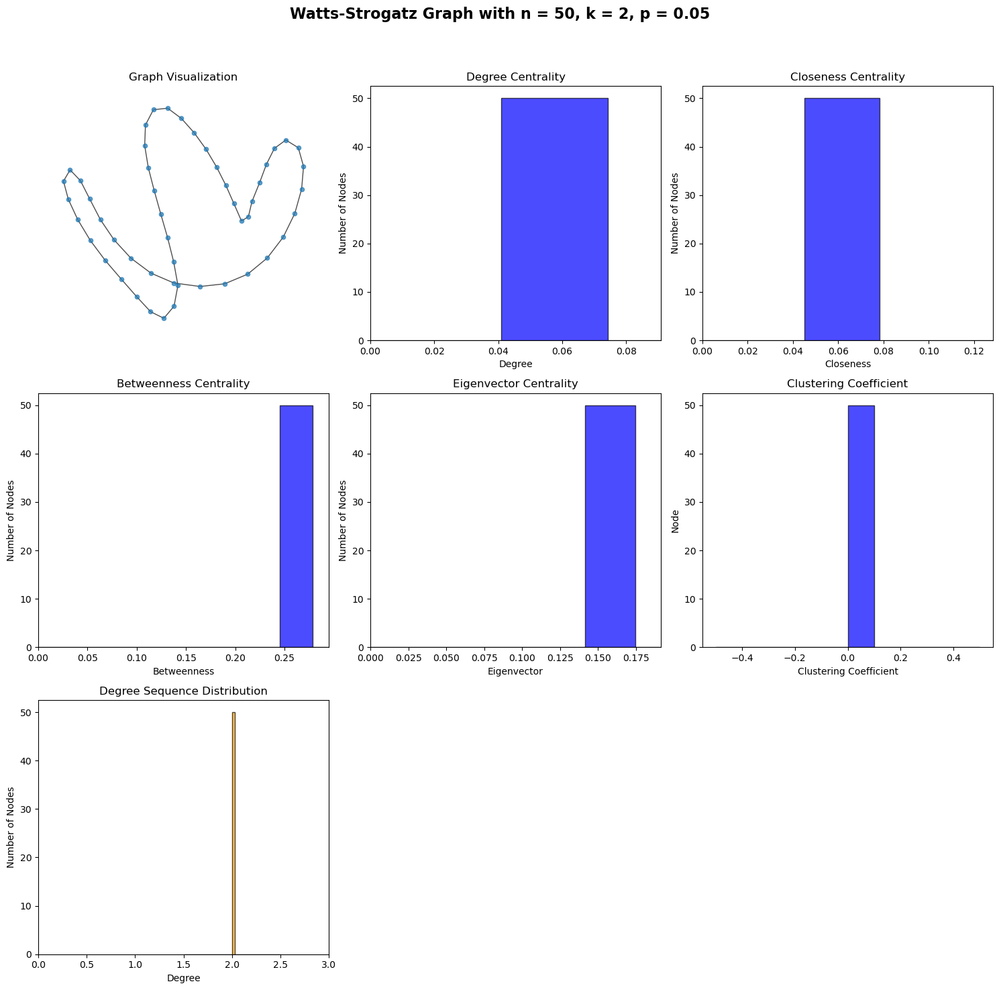

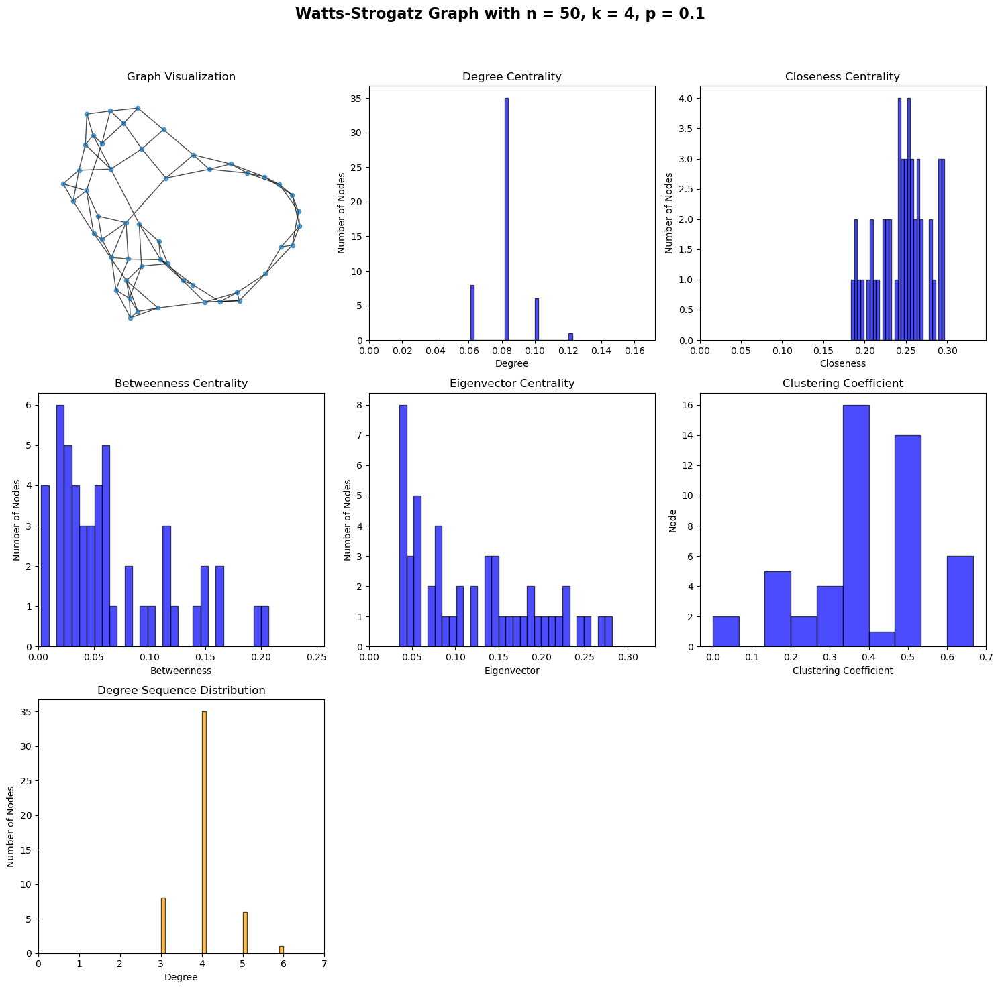

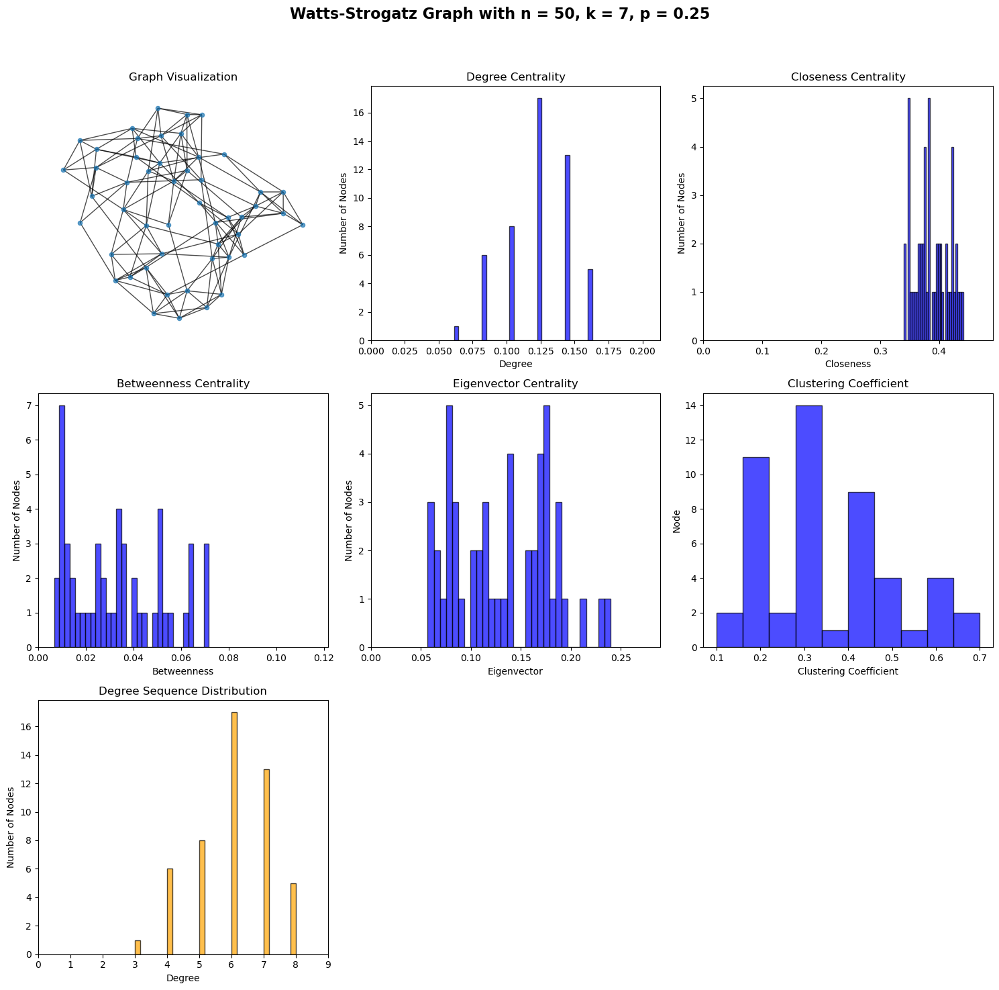

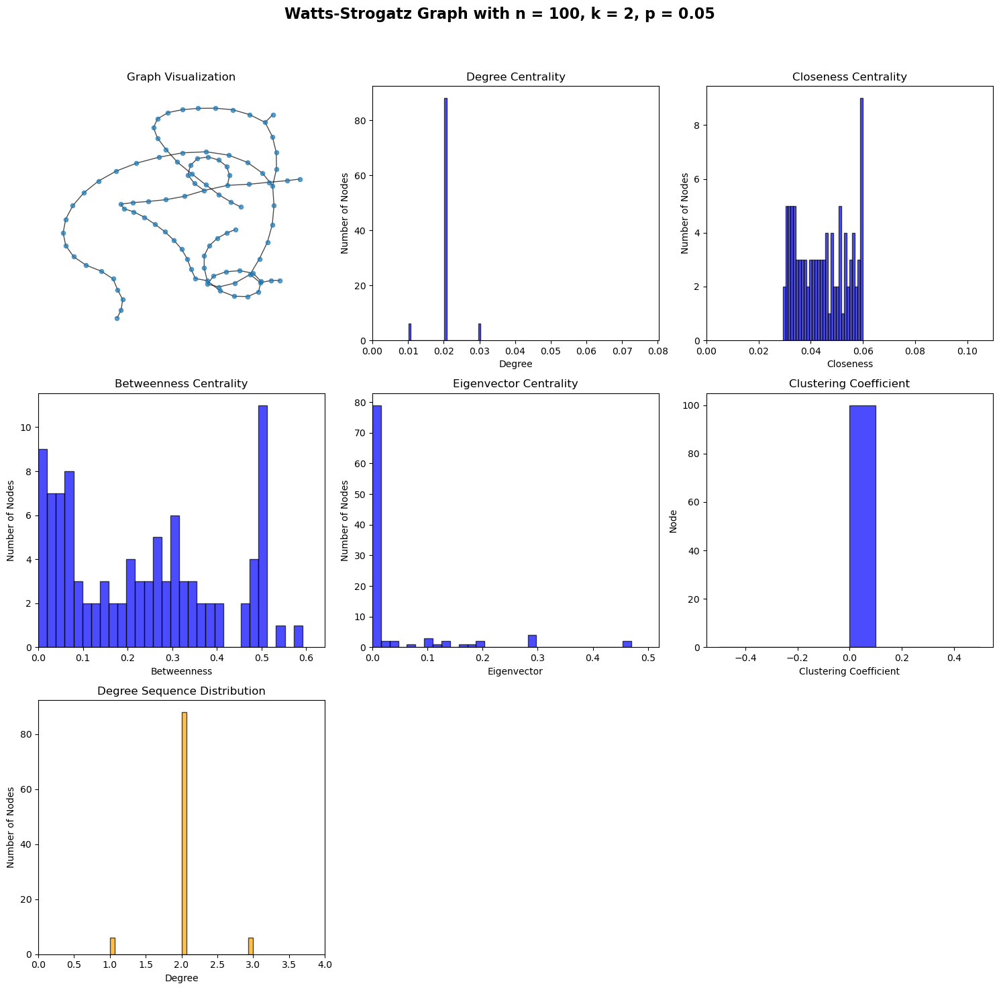

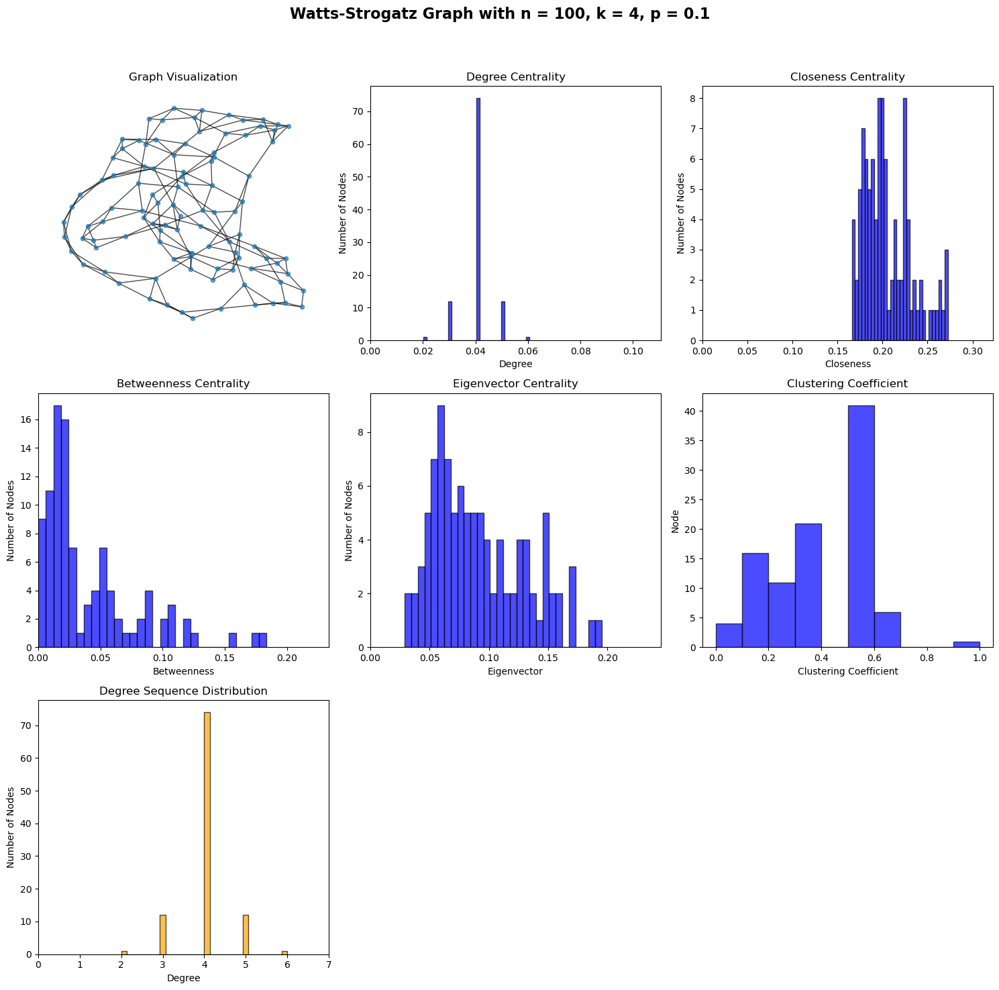

...

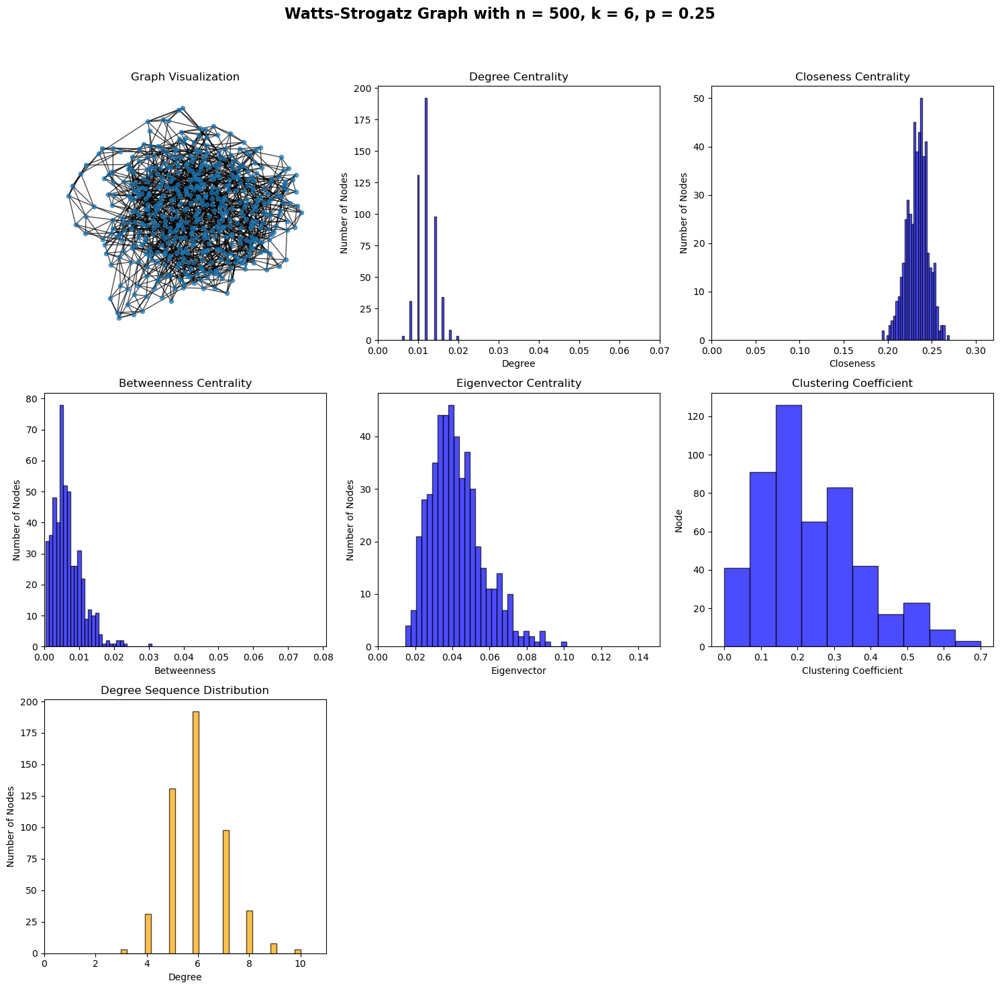

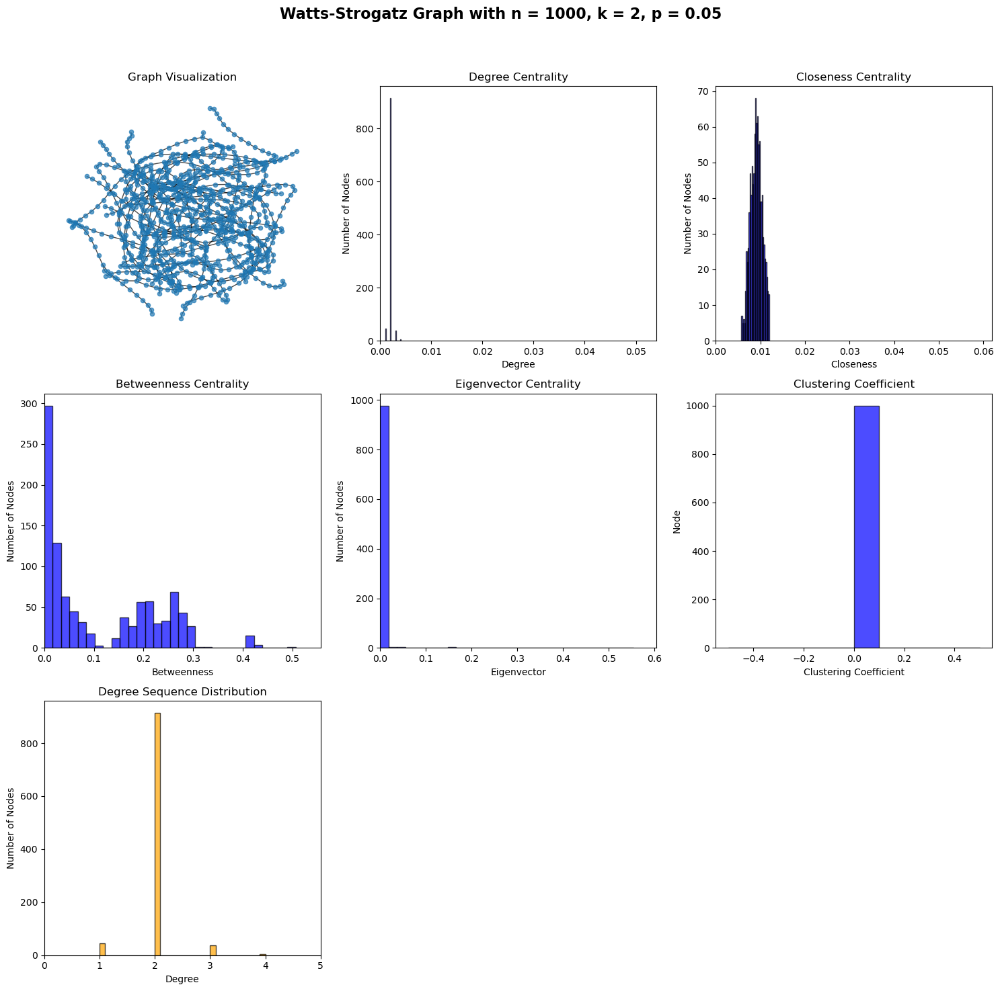

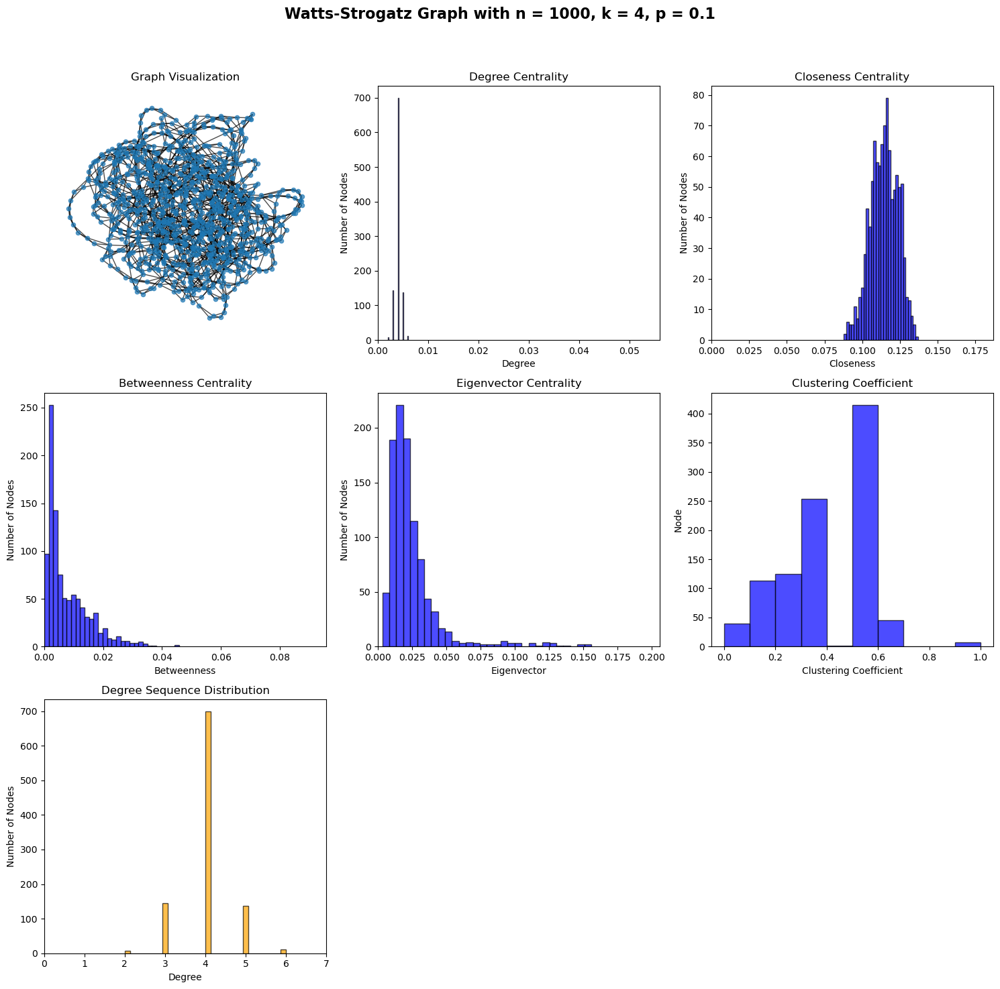

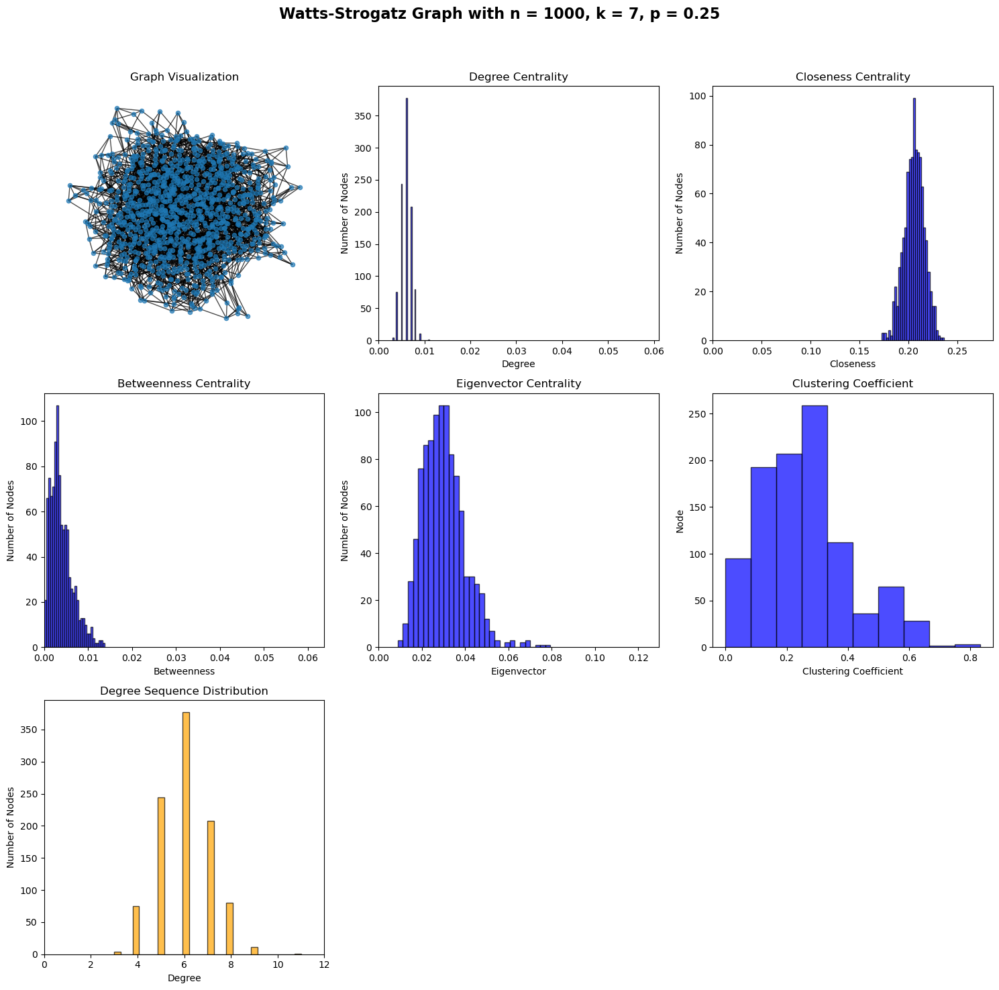

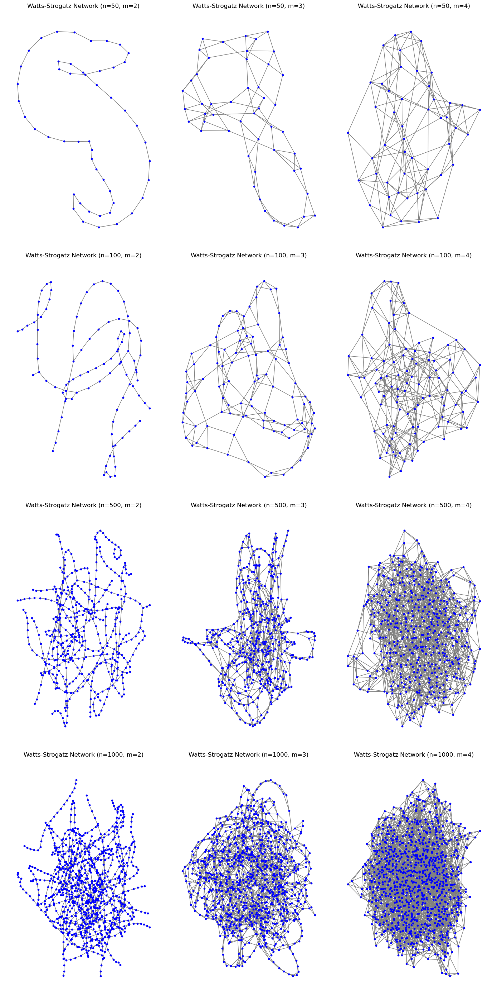

In [58]:
#list of values for network parameters
nodes_list = [50, 100, 500, 1000]
kp_list = [(2,0.05), (4, 0.1), (6,0.25)]


#watts-strogatz network
graph_ws_list = []
graph_name = "Watts-Strogatz"
for nodes in nodes_list:
    for kp in kp_list:
        k = kp[0]
        p = kp[1]
        g_ws = nx.watts_strogatz_graph(nodes, k, p)
        graph_ws_list.append(g_ws)
        stats = statistical_measures(g_ws)
        plot_statistics(stats, g_ws, graph_name, p)

plot_network(graph_ws_list, graph_name)







#### Erdos-Renyi Graph

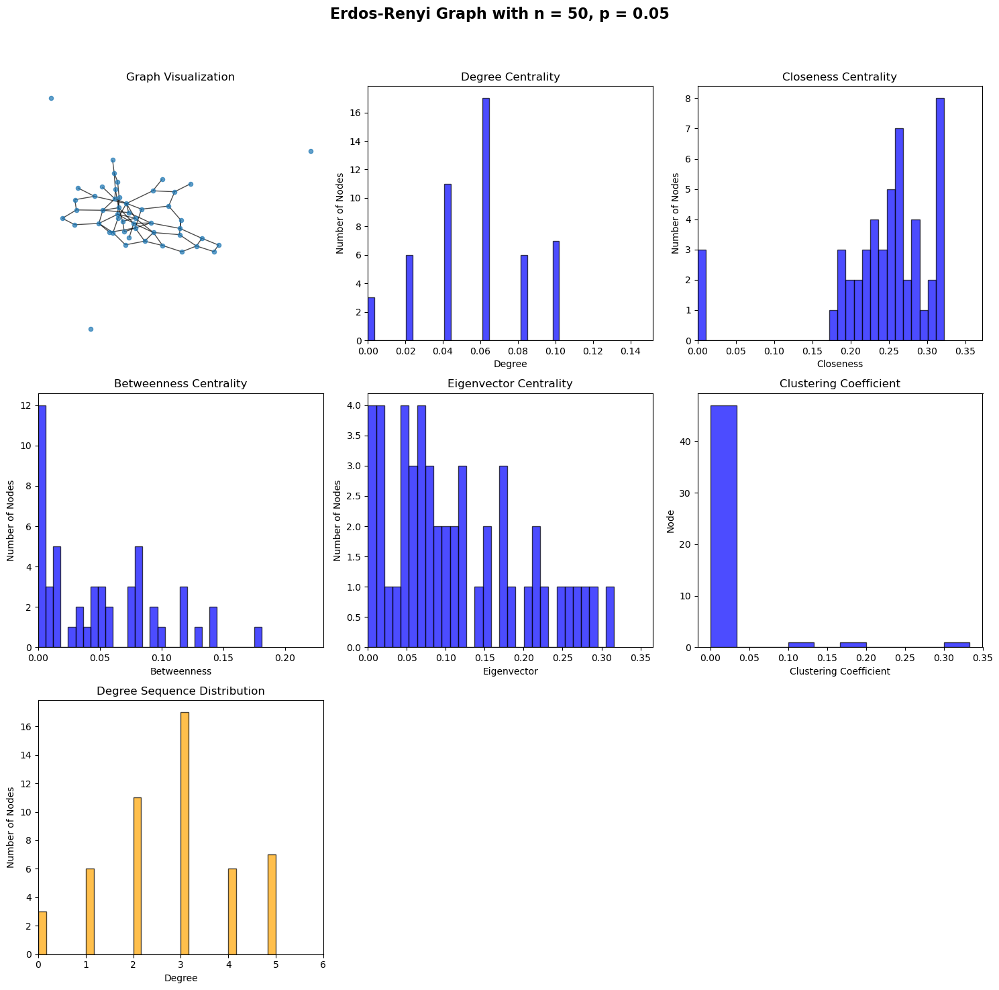

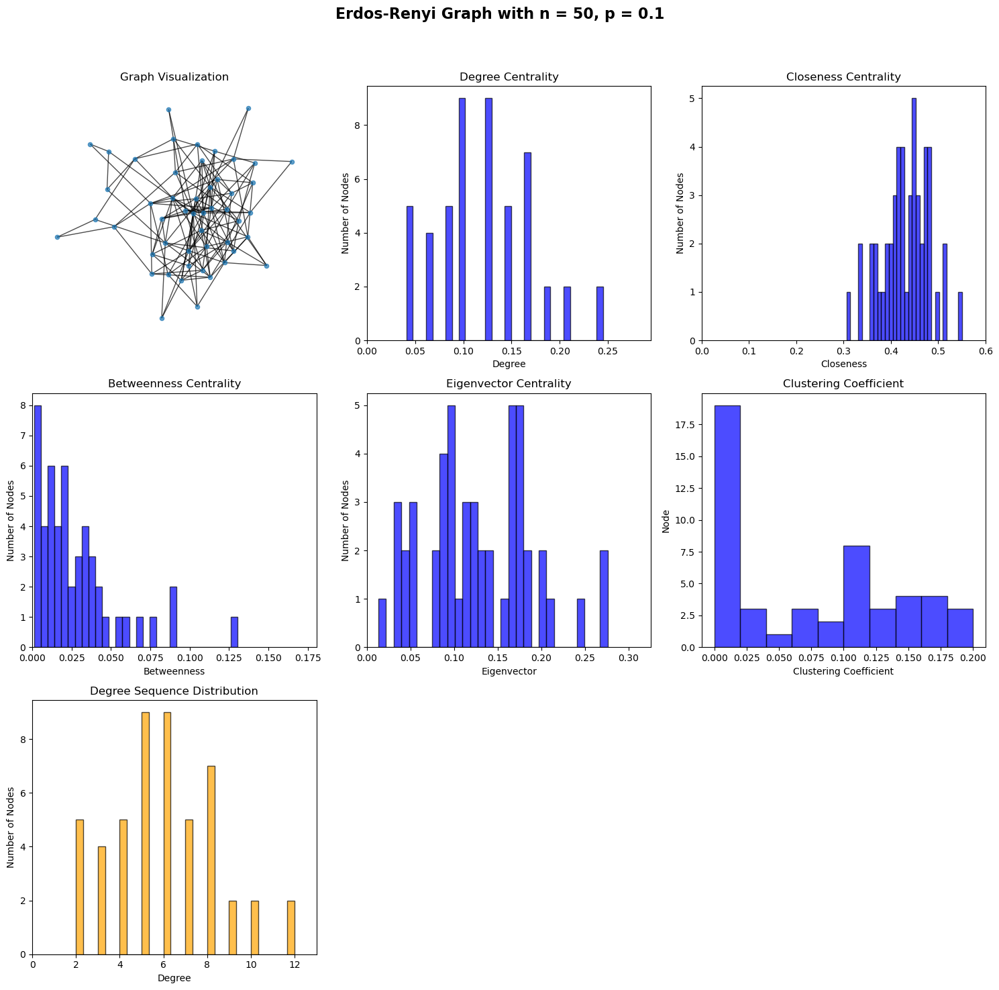

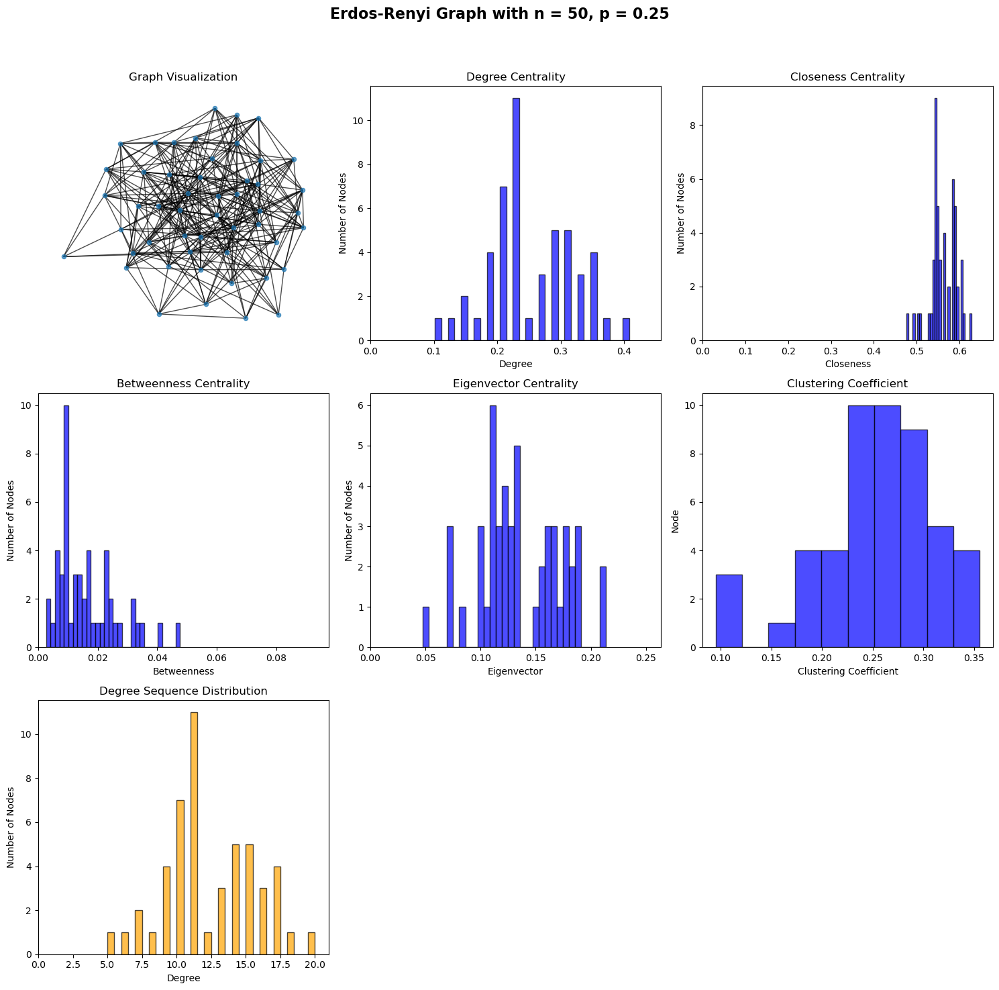

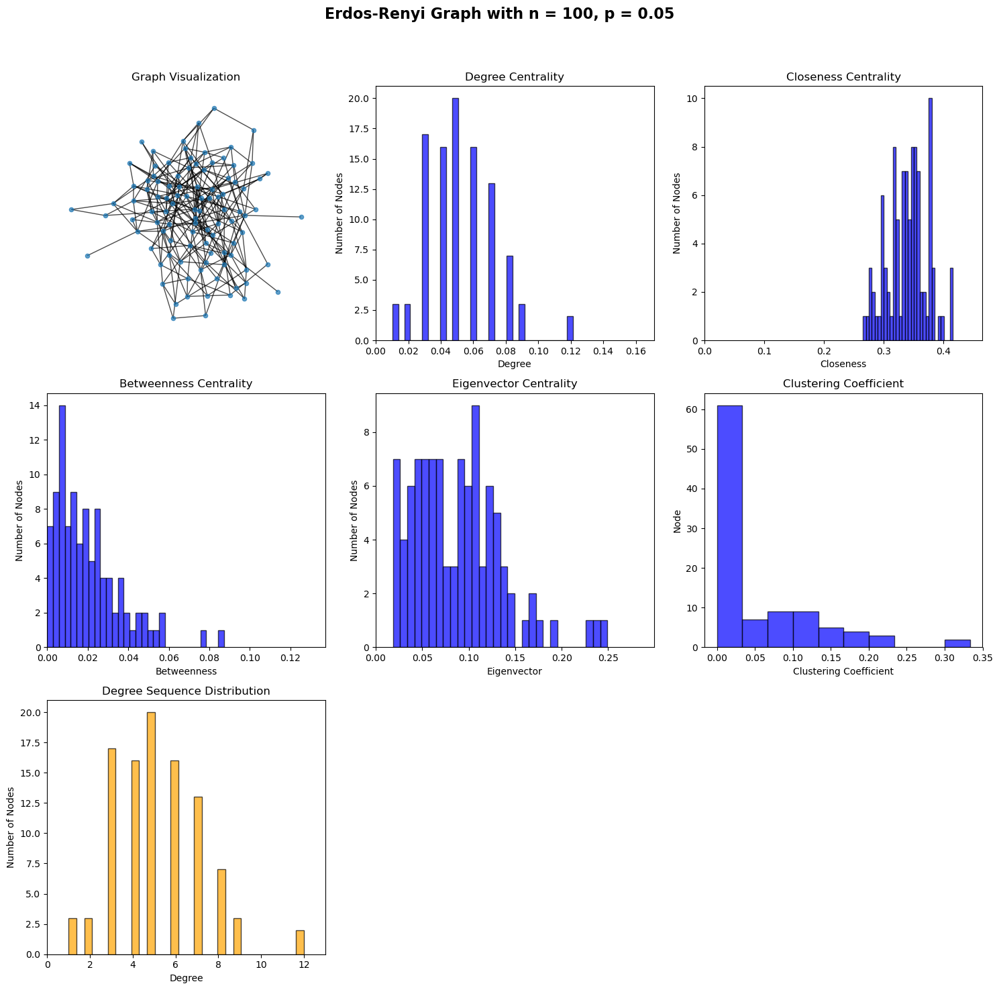

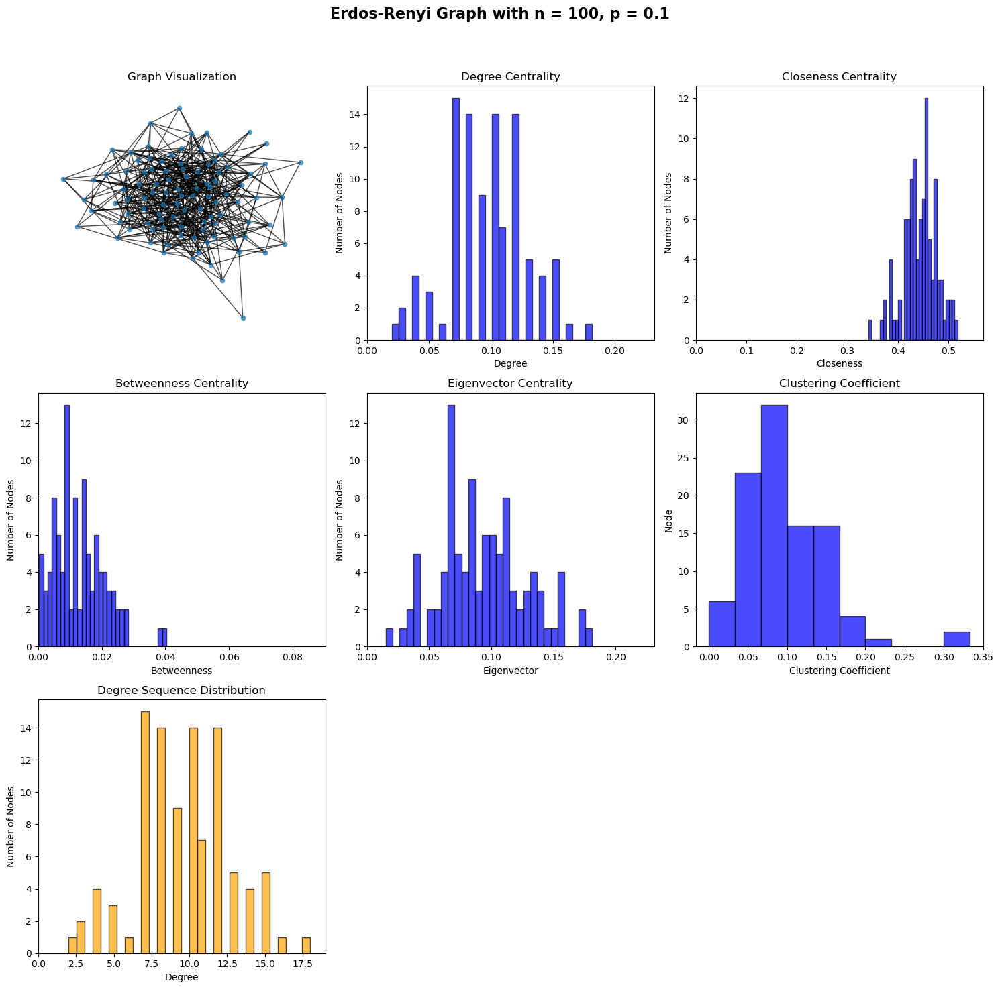

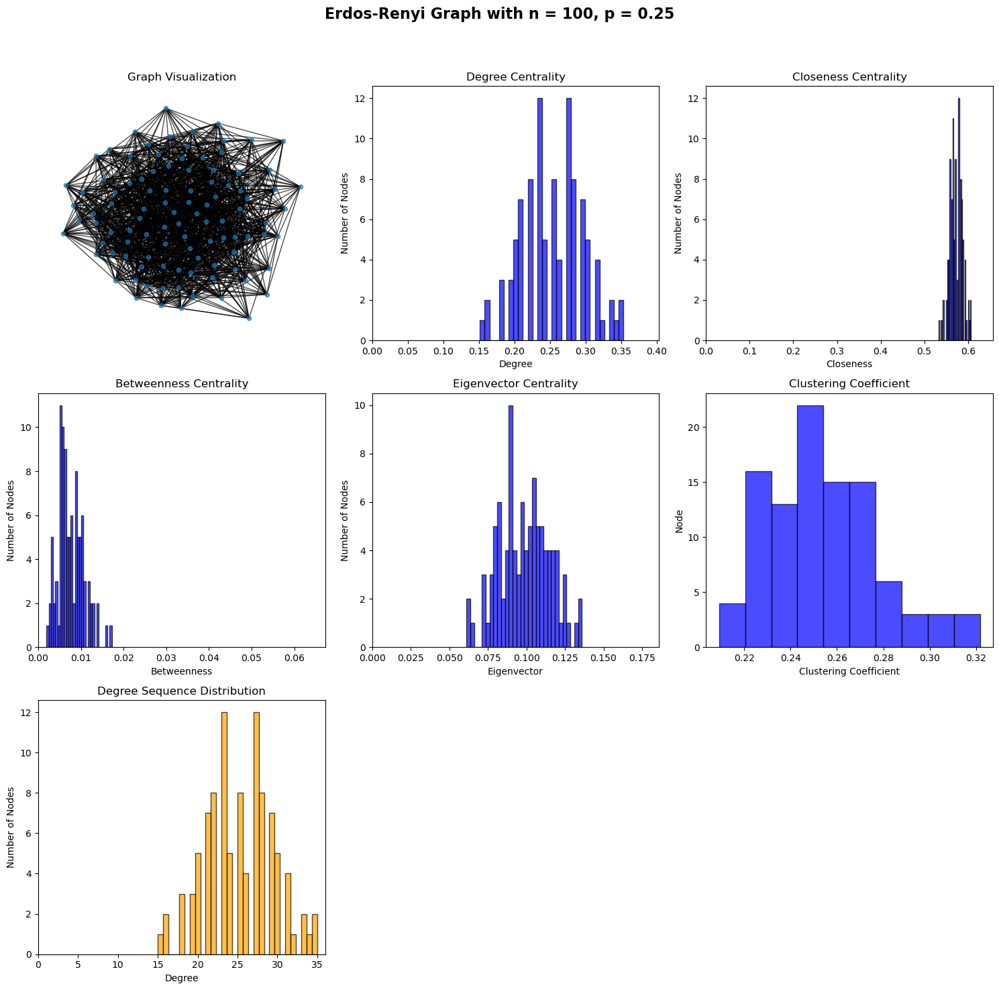

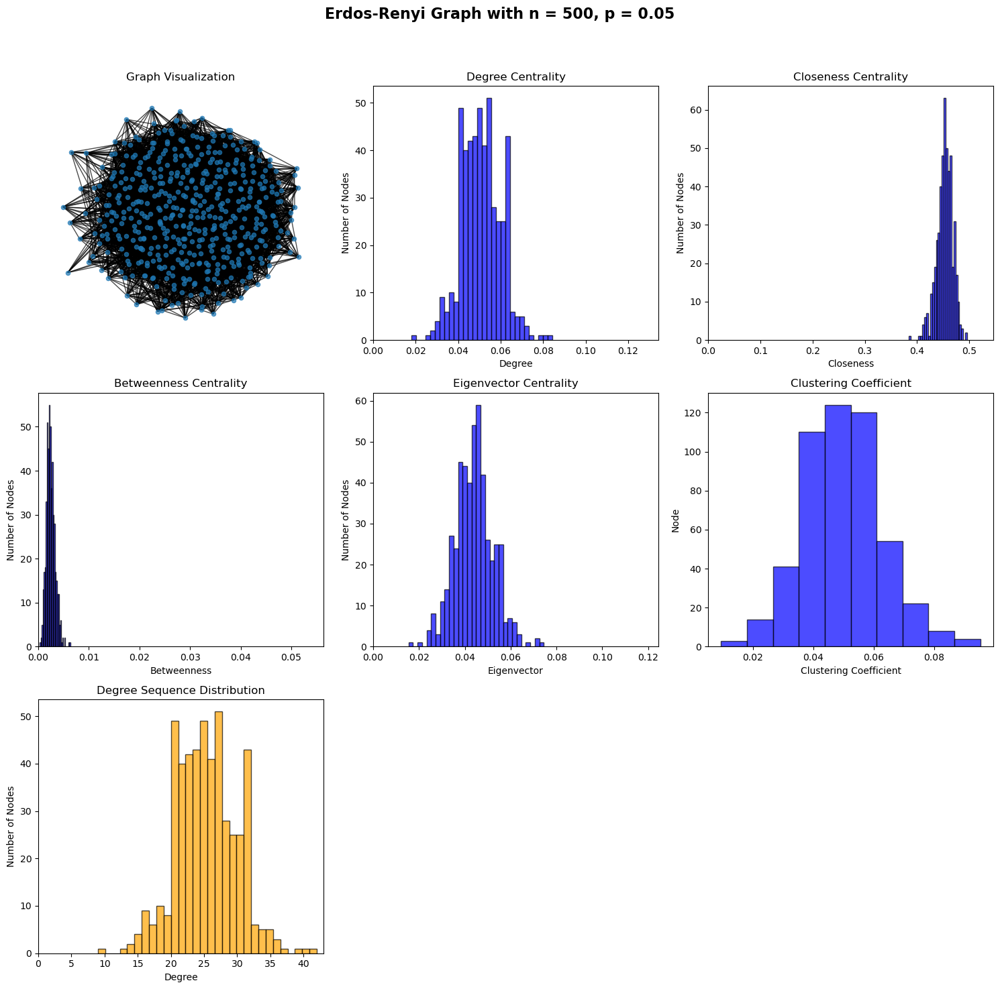

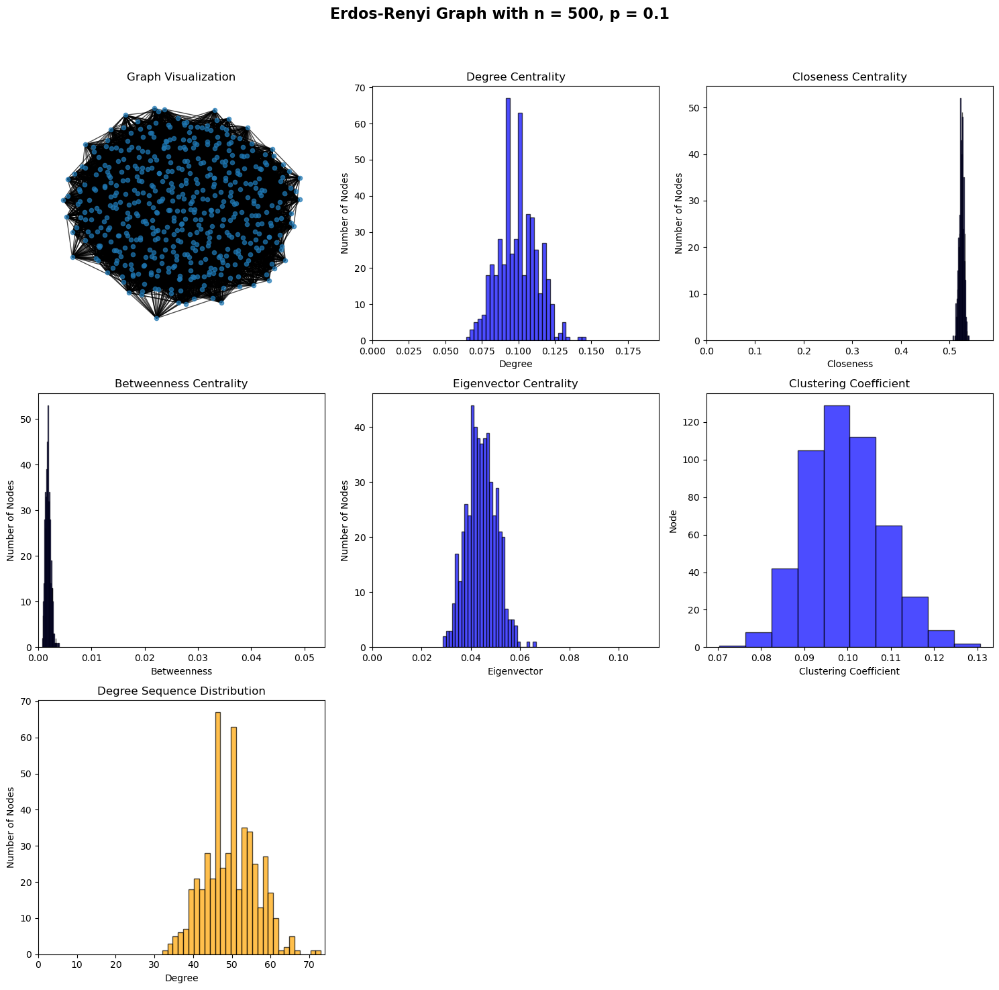

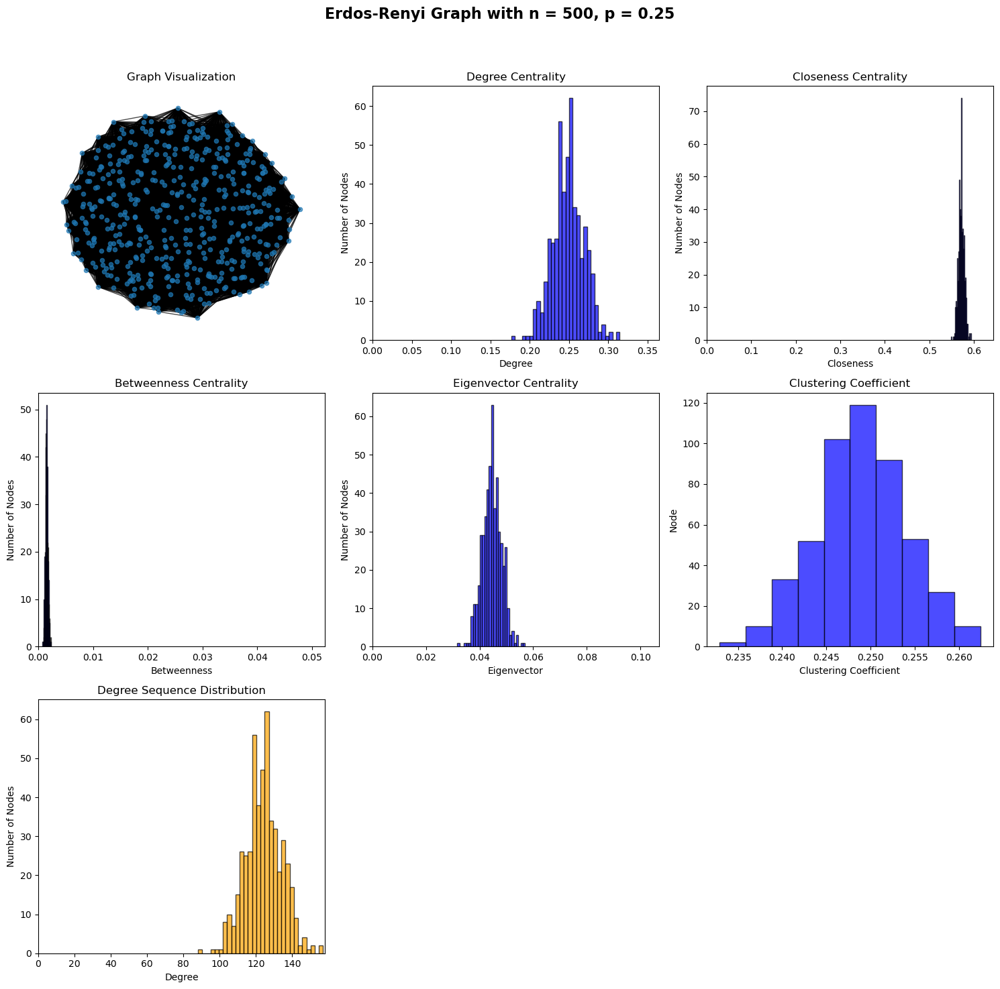

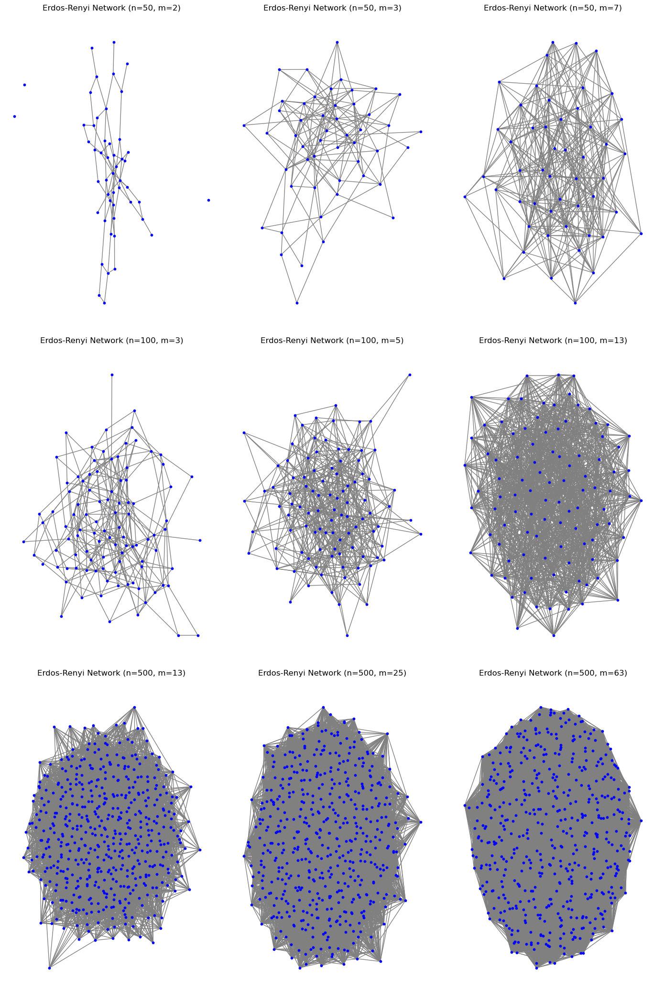

In [59]:
#list of values for network parameters
nodes_list = [50, 100, 500]
p_list = [0.05, 0.1, 0.25]


#watts-strogatz network
graph_er_list = []
graph_name = "Erdos-Renyi"
for nodes in nodes_list:
    for p in p_list:
        g_er = nx.erdos_renyi_graph(nodes, p)
        graph_er_list.append(g_er)
        stats = statistical_measures(g_er)
        plot_statistics(stats, g_er, graph_name, p)

plot_network(graph_er_list, graph_name)







### Simulate SIR spread on the network

We investigated how network structure and disease dynamics interact through SIR simulations on Barabási-Albert, Watts-Strogatz, and Erdős-Rényi networks. Different initial infection scenarios—targeting high-degree nodes or selecting randomly—were explored. The simulations varied transmission rates, recovery rates, and the fraction of initially infected nodes to capture stochastic variability in the epidemic's spread.

#### Barabasi-Albert Graph

In [60]:
from bokeh.models import Div
from bokeh.layouts import column
import random

#find initially infected nodes, 5 nodes with the highest degree or closeness centrality 
def get_initial_infected_nodes(g, type, num_nodes=5):
    if type == "Degree":
        degree_centrality = nx.degree_centrality(g)
        sorted_degree = sorted(degree_centrality, key = degree_centrality.get, reverse = True)
        top_degree_nodes = sorted_degree[:num_nodes]
    elif type == "Closeness":
        closeness_centrality = nx.closeness_centrality(g)
        sorted_closeness = sorted(closeness_centrality, key = closeness_centrality.get, reverse = True)
        top_degree_nodes = sorted_closeness[:num_nodes]
    elif type == "Random":
        top_degree_nodes = random.sample(list(g.nodes()), num_nodes)
    print(f"Initial Infected Nodes: {top_degree_nodes}")
    return top_degree_nodes

def create_SIR(g, beta, gamma, initial_infected_nodes):
    model = ep.SIRModel(g)
    config = mc.Configuration()
    config.add_model_parameter('beta', beta)
    config.add_model_parameter('gamma', gamma)
    config.add_model_initial_configuration("Infected", initial_infected_nodes)
    model.set_initial_status(config)
    iterations = model.iteration_bunch(2000)
    trends = model.build_trends(iterations)
    return model, trends

# Function to plot the SIR trends with degree and closeness centrality
def plot_SIR(degree_list, closeness_list, beta, gamma, fraction):
    output_notebook()  # To display plots in Jupyter or notebooks

    plots = []

    # Create 3 plots for Degree Centrality-based infection
    for i in range(3):  # We create 3 similar degree centrality plots for demonstration
        viz_degree = DiffusionTrend(degree_list[i][0], degree_list[i][1])
        p_degree = viz_degree.plot(width=350, height=450 )

        plots.append(p_degree)

    # Create 3 plots for Closeness Centrality-based infection
    for i in range(3):  # We create 3 similar closeness centrality plots for demonstration
        viz_closeness = DiffusionTrend(closeness_list[i][0], closeness_list[i][1])
        p_closeness = viz_closeness.plot(width=350, height=450)

        plots.append(p_closeness)

    # Add titles for each row
    degree_title = Div(text=f"<h3>Degree Centrality Plots (β={beta}, γ={gamma}, Fraction={fraction})</h3>", width=1050)
    closeness_title = Div(text=f"<h3>Random Plots (β={beta}, γ={gamma}, Fraction={fraction})</h3>", width=1050)

    # Organize Degree plots in the first row, Closeness in the second
    degree_row = gridplot(plots[:3], ncols=3)  # First 3 plots are Degree Centrality
    closeness_row = gridplot(plots[3:], ncols=3)  # Next 3 plots are Closeness Centrality
    layout = column(degree_title, degree_row, closeness_title, closeness_row)


    # Display the grid of plots
    show(layout)

# list of values for the disease parameters
beta_list = [0.001, 0.005, 0.01]
gamma_list = [0.001, 0.004, 0.007]
fraction_list = [0.01, 0.05, 0.1]

# Network Definition
#values for network parameters of Barabasi-ALbert
nodes = 200
edge = 3
g_ba = nx.barabasi_albert_graph(nodes, edge)
nodes2 = 500

beta_sol_degree = []
beta_sol_closeness = []
beta_sol_random = []
for beta in beta_list:
    gamma = 0.001
    fraction = 0.025
    infected_nodes_degree = get_initial_infected_nodes(g_ba, "Degree")
    #infected_nodes_closeness = get_initial_infected_nodes(g_ba, "Closeness")
    infected_nodes_random = get_initial_infected_nodes(g_ba, "Random")
    model_degree, trends_degree = create_SIR(g_ba, beta, gamma, infected_nodes_degree)
    #model_closeness, trends_closeness = create_SIR(g_ba, beta, gamma, infected_nodes_closeness)
    model_random, trends_random = create_SIR(g_ba, beta, gamma, infected_nodes_random)
    beta_sol_degree.append((model_degree, trends_degree))
    #beta_sol_closeness.append((model_closeness, trends_closeness))
    beta_sol_random.append((model_random, trends_random))
#plot_SIR(beta_sol_degree, beta_sol_closeness, beta_list, gamma, fraction)
plot_SIR(beta_sol_degree, beta_sol_random, beta_list, gamma, fraction)

gamma_sol_degree = []
gamma_sol_closeness = []
gamma_sol_random = []
for gamma in gamma_list:
    beta = 0.001
    fraction = 0.025
    infected_nodes_degree = get_initial_infected_nodes(g_ba, "Degree")
    #infected_nodes_closeness = get_initial_infected_nodes(g_ba, "Closeness")
    infected_nodes_random = get_initial_infected_nodes(g_ba, "Random")
    model_degree, trends_degree = create_SIR(g_ba, beta, gamma, infected_nodes_degree)
    #model_closeness, trends_closeness = create_SIR(g_ba, beta, gamma, infected_nodes_closeness)
    model_random, trends_random = create_SIR(g_ba, beta, gamma, infected_nodes_random)
    gamma_sol_degree.append((model_degree, trends_degree))
    #gamma_sol_closeness.append((model_closeness, trends_closeness))
    gamma_sol_random.append((model_random, trends_random))

#plot_SIR(gamma_sol_degree, gamma_sol_closeness, beta, gamma_list, fraction)
plot_SIR(gamma_sol_degree, gamma_sol_random, beta, gamma_list, fraction)
    

fraction_sol_degree = []
fraction_sol_closeness = []
fraction_sol_random = []
for fraction in fraction_list:
    beta = 0.001
    gamma = 0.001
    infected_nodes_degree = get_initial_infected_nodes(g_ba, "Degree", int(fraction*nodes))
    #infected_nodes_closeness = get_initial_infected_nodes(g_ba, "Closeness", int(fraction*nodes))
    infected_nodes_random = get_initial_infected_nodes(g_ba, "Random", int(fraction*nodes))
    model_degree, trends_degree = create_SIR(g_ba, beta, gamma, infected_nodes_degree)
    #model_closeness, trends_closeness = create_SIR(g_ba, beta, gamma, infected_nodes_closeness)
    fraction_sol_degree.append((model_degree, trends_degree))
    #fraction_sol_closeness.append((model_closeness, trends_closeness))
    fraction_sol_random.append((model_random, trends_random))
#plot_SIR(fraction_sol_degree, fraction_sol_closeness, beta, gamma, fraction_list)
plot_SIR(fraction_sol_degree, fraction_sol_random, beta, gamma, fraction_list)
    
            





Initial Infected Nodes: [4, 0, 3, 11, 15]
Initial Infected Nodes: [59, 124, 103, 171, 56]


100%|██████████| 2000/2000 [00:00<00:00, 5131.06it/s]


Initial Infected Nodes: [4, 0, 3, 11, 15]
Initial Infected Nodes: [5, 13, 138, 59, 80]


100%|██████████| 2000/2000 [00:00<00:00, 5148.05it/s]


Initial Infected Nodes: [4, 0, 3, 11, 15]
Initial Infected Nodes: [157, 123, 177, 8, 148]


100%|██████████| 2000/2000 [00:00<00:00, 5194.31it/s]


Loading BokehJS ...

Initial Infected Nodes: [4, 0, 3, 11, 15]
Initial Infected Nodes: [88, 24, 172, 30, 51]


100%|██████████| 2000/2000 [00:00<00:00, 4150.49it/s]


Initial Infected Nodes: [4, 0, 3, 11, 15]
Initial Infected Nodes: [132, 165, 153, 82, 14]


100%|██████████| 2000/2000 [00:00<00:00, 8133.05it/s]


Initial Infected Nodes: [4, 0, 3, 11, 15]
Initial Infected Nodes: [180, 54, 157, 16, 146]


100%|██████████| 2000/2000 [00:00<00:00, 12191.31it/s]


Loading BokehJS ...

Initial Infected Nodes: [4, 0]
Initial Infected Nodes: [45, 102]


100%|██████████| 2000/2000 [00:00<00:00, 4527.85it/s]


Initial Infected Nodes: [4, 0, 3, 11, 15, 21, 5, 6, 13, 28]
Initial Infected Nodes: [36, 153, 98, 43, 0, 17, 145, 184, 65, 1]


100%|██████████| 2000/2000 [00:00<00:00, 4573.22it/s]


Initial Infected Nodes: [4, 0, 3, 11, 15, 21, 5, 6, 13, 28, 1, 16, 17, 18, 12, 20, 47, 8, 65, 10]
Initial Infected Nodes: [102, 32, 158, 49, 38, 30, 45, 51, 145, 73, 71, 75, 96, 66, 8, 192, 78, 189, 141, 182]


100%|██████████| 2000/2000 [00:00<00:00, 4789.55it/s]


Loading BokehJS ...

#### Watts-Strogatz Graph

In [61]:
# list of values for the disease parameters
beta_list = [0.001, 0.005, 0.01]
gamma_list = [0.001, 0.004, 0.007]
fraction_list = [0.01, 0.1, 0.25]

# Network Definition
#values for network parameters of Barabasi-ALbert
nodes = 200
k = 4
p = 0.1
g_ws = nx.watts_strogatz_graph(nodes, k, p)

beta_sol_degree = []
beta_sol_closeness = []
beta_sol_random = []
for beta in beta_list:
    gamma = 0.001
    fraction = 0.025
    infected_nodes_degree = get_initial_infected_nodes(g_ws, "Degree")
    #infected_nodes_closeness = get_initial_infected_nodes(g_ws, "Closeness")
    infected_nodes_random = get_initial_infected_nodes(g_ws, "Random")
    model_degree, trends_degree = create_SIR(g_ws, beta, gamma, infected_nodes_degree)
    #model_closeness, trends_closeness = create_SIR(g_ws, beta, gamma, infected_nodes_closeness)
    model_random, trends_random = create_SIR(g_ws, beta, gamma, infected_nodes_random)
    beta_sol_degree.append((model_degree, trends_degree))
    #beta_sol_closeness.append((model_closeness, trends_closeness))
    beta_sol_random.append((model_random, trends_random))
#plot_SIR(beta_sol_degree, beta_sol_closeness, beta_list, gamma, fraction)
plot_SIR(beta_sol_degree, beta_sol_random, beta_list, gamma, fraction)

gamma_sol_degree = []
gamma_sol_closeness = []
gamma_sol_random = []
for gamma in gamma_list:
    beta = 0.005
    fraction = 0.025
    infected_nodes_degree = get_initial_infected_nodes(g_ws, "Degree")
    #infected_nodes_closeness = get_initial_infected_nodes(g_ws, "Closeness")
    infected_nodes_random = get_initial_infected_nodes(g_ws, "Random")
    model_degree, trends_degree = create_SIR(g_ws, beta, gamma, infected_nodes_degree)
    #model_closeness, trends_closeness = create_SIR(g_ws, beta, gamma, infected_nodes_closeness)
    model_random, trends_random = create_SIR(g_ws, beta, gamma, infected_nodes_random)
    gamma_sol_degree.append((model_degree, trends_degree))
    #gamma_sol_closeness.append((model_closeness, trends_closeness))
    gamma_sol_random.append((model_random, trends_random))
#plot_SIR(gamma_sol_degree, gamma_sol_closeness, beta, gamma_list, fraction)
plot_SIR(gamma_sol_degree, gamma_sol_random, beta, gamma_list, fraction)
    

fraction_sol_degree = []
fraction_sol_closeness = []
fraction_sol_random = []
for fraction in fraction_list:
    beta = 0.005
    gamma = 0.001
    infected_nodes_degree = get_initial_infected_nodes(g_ws, "Degree", int(fraction*nodes))
    #infected_nodes_closeness = get_initial_infected_nodes(g_ws, "Closeness", int(fraction*nodes))
    infected_nodes_random = get_initial_infected_nodes(g_ws, "Random", int(fraction*nodes))
    model_degree, trends_degree = create_SIR(g_ws, beta, gamma, infected_nodes_degree)
    #model_closeness, trends_closeness = create_SIR(g_ws, beta, gamma, infected_nodes_closeness)
    model_random, trends_random = create_SIR(g_ws, beta, gamma, infected_nodes_random)
    fraction_sol_degree.append((model_degree, trends_degree))
    #fraction_sol_closeness.append((model_closeness, trends_closeness))
    fraction_sol_random.append((model_random, trends_random))
#plot_SIR(fraction_sol_degree, fraction_sol_closeness, beta, gamma, fraction_list)
plot_SIR(fraction_sol_degree, fraction_sol_random, beta, gamma, fraction_list)
    
            





Initial Infected Nodes: [49, 112, 2, 3, 7]
Initial Infected Nodes: [148, 197, 97, 83, 107]


100%|██████████| 2000/2000 [00:00<00:00, 8683.68it/s]


Initial Infected Nodes: [49, 112, 2, 3, 7]
Initial Infected Nodes: [66, 73, 179, 46, 19]


100%|██████████| 2000/2000 [00:00<00:00, 5599.48it/s]


Initial Infected Nodes: [49, 112, 2, 3, 7]
Initial Infected Nodes: [174, 181, 1, 113, 109]


100%|██████████| 2000/2000 [00:00<00:00, 5418.76it/s]


Loading BokehJS ...

Initial Infected Nodes: [49, 112, 2, 3, 7]
Initial Infected Nodes: [2, 118, 20, 88, 191]


100%|██████████| 2000/2000 [00:00<00:00, 5052.04it/s]


Initial Infected Nodes: [49, 112, 2, 3, 7]
Initial Infected Nodes: [87, 169, 22, 160, 146]


100%|██████████| 2000/2000 [00:00<00:00, 8565.01it/s]


Initial Infected Nodes: [49, 112, 2, 3, 7]
Initial Infected Nodes: [143, 85, 39, 62, 43]


100%|██████████| 2000/2000 [00:00<00:00, 10580.79it/s]


Loading BokehJS ...

Initial Infected Nodes: [49, 112]
Initial Infected Nodes: [180, 16]


100%|██████████| 2000/2000 [00:00<00:00, 5950.72it/s]


Initial Infected Nodes: [49, 112, 2, 3, 7, 12, 16, 17, 21, 23, 26, 31, 36, 44, 50, 58, 67, 73, 77, 80]
Initial Infected Nodes: [198, 157, 6, 57, 135, 86, 147, 141, 88, 130, 70, 132, 105, 119, 154, 31, 189, 140, 199, 32]


100%|██████████| 2000/2000 [00:00<00:00, 5467.63it/s]


Initial Infected Nodes: [49, 112, 2, 3, 7, 12, 16, 17, 21, 23, 26, 31, 36, 44, 50, 58, 67, 73, 77, 80, 83, 87, 93, 98, 123, 130, 135, 145, 163, 173, 176, 178, 183, 186, 0, 1, 4, 5, 6, 8, 9, 10, 14, 15, 18, 20, 22, 25, 27, 29]
Initial Infected Nodes: [50, 133, 167, 194, 60, 149, 117, 55, 52, 126, 172, 22, 106, 20, 70, 15, 63, 75, 21, 78, 23, 86, 112, 27, 58, 9, 66, 74, 77, 174, 31, 49, 120, 87, 154, 83, 90, 62, 132, 196, 130, 181, 95, 150, 103, 37, 125, 129, 39, 136]


100%|██████████| 2000/2000 [00:00<00:00, 3521.28it/s]


Loading BokehJS ...

#### Erdos-Renyi Graph

In [62]:
# list of values for the disease parameters
beta_list = [0.0005, 0.001, 0.005]
gamma_list = [0.001, 0.004, 0.007]
fraction_list = [0.01, 0.1, 0.25]

# Network Definition
#values for network parameters of Barabasi-ALbert
nodes = 200
p = 0.05
g_er = nx.erdos_renyi_graph(nodes, p)

beta_sol_degree = []
beta_sol_closeness = []
beta_sol_random = []
for beta in beta_list:
    gamma = 0.001
    fraction = 0.025
    infected_nodes_degree = get_initial_infected_nodes(g_er, "Degree")
    #infected_nodes_closeness = get_initial_infected_nodes(g_er, "Closeness")
    infected_nodes_random = get_initial_infected_nodes(g_er, "Random")
    model_degree, trends_degree = create_SIR(g_er, beta, gamma, infected_nodes_degree)
    #model_closeness, trends_closeness = create_SIR(g_er, beta, gamma, infected_nodes_closeness)
    model_random, trends_random = create_SIR(g_er, beta, gamma, infected_nodes_random)
    beta_sol_degree.append((model_degree, trends_degree))
    #beta_sol_closeness.append((model_closeness, trends_closeness))
    beta_sol_random.append((model_random, trends_random))
#plot_SIR(beta_sol_degree, beta_sol_closeness, beta_list, gamma, fraction)
plot_SIR(beta_sol_degree, beta_sol_random, beta_list, gamma, fraction)

gamma_sol_degree = []
gamma_sol_closeness = []
gamma_sol_random = []
for gamma in gamma_list:
    beta = 0.001
    fraction = 0.025
    infected_nodes_degree = get_initial_infected_nodes(g_er, "Degree")
    #infected_nodes_closeness = get_initial_infected_nodes(g_er, "Closeness")
    infected_nodes_random = get_initial_infected_nodes(g_er, "Random")
    model_degree, trends_degree = create_SIR(g_er, beta, gamma, infected_nodes_degree)
    #model_closeness, trends_closeness = create_SIR(g_er, beta, gamma, infected_nodes_closeness)
    model_random, trends_random = create_SIR(g_er, beta, gamma, infected_nodes_random)
    gamma_sol_degree.append((model_degree, trends_degree))
    #gamma_sol_closeness.append((model_closeness, trends_closeness))
    gamma_sol_random.append((model_random, trends_random))
#plot_SIR(gamma_sol_degree, gamma_sol_closeness, beta, gamma_list, fraction)
plot_SIR(gamma_sol_degree, gamma_sol_random, beta, gamma_list, fraction)
    

fraction_sol_degree = []
fraction_sol_closeness = []
fraction_sol_random = []
for fraction in fraction_list:
    beta = 0.001
    gamma = 0.001
    infected_nodes_degree = get_initial_infected_nodes(g_er, "Degree", int(fraction*nodes))
    #infected_nodes_closeness = get_initial_infected_nodes(g_er, "Closeness", int(fraction*nodes))
    infected_nodes_random = get_initial_infected_nodes(g_er, "Random", int(fraction*nodes))
    model_degree, trends_degree = create_SIR(g_er, beta, gamma, infected_nodes_degree)
    #model_closeness, trends_closeness = create_SIR(g_er, beta, gamma, infected_nodes_closeness)
    model_random, trends_random = create_SIR(g_er, beta, gamma, infected_nodes_random)
    fraction_sol_degree.append((model_degree, trends_degree))
    #fraction_sol_closeness.append((model_closeness, trends_closeness))
    fraction_sol_random.append((model_random, trends_random))
#plot_SIR(fraction_sol_degree, fraction_sol_closeness, beta, gamma, fraction_list)
plot_SIR(fraction_sol_degree, fraction_sol_random, beta, gamma, fraction_list)

Initial Infected Nodes: [49, 78, 53, 56, 47]
Initial Infected Nodes: [93, 167, 30, 79, 23]


100%|██████████| 2000/2000 [00:00<00:00, 4542.41it/s]


Initial Infected Nodes: [49, 78, 53, 56, 47]
Initial Infected Nodes: [60, 187, 81, 5, 84]


100%|██████████| 2000/2000 [00:00<00:00, 4370.30it/s]


Initial Infected Nodes: [49, 78, 53, 56, 47]
Initial Infected Nodes: [38, 144, 67, 32, 150]


100%|██████████| 2000/2000 [00:00<00:00, 4610.40it/s]


Loading BokehJS ...

Initial Infected Nodes: [49, 78, 53, 56, 47]
Initial Infected Nodes: [70, 33, 19, 155, 171]


100%|██████████| 2000/2000 [00:00<00:00, 4474.41it/s]


Initial Infected Nodes: [49, 78, 53, 56, 47]
Initial Infected Nodes: [36, 154, 95, 45, 92]


100%|██████████| 2000/2000 [00:00<00:00, 7328.13it/s]


Initial Infected Nodes: [49, 78, 53, 56, 47]
Initial Infected Nodes: [93, 139, 86, 165, 9]


100%|██████████| 2000/2000 [00:00<00:00, 8682.07it/s]


Loading BokehJS ...

Initial Infected Nodes: [49, 78]
Initial Infected Nodes: [179, 60]


100%|██████████| 2000/2000 [00:00<00:00, 4588.29it/s]


Initial Infected Nodes: [49, 78, 53, 56, 47, 77, 180, 11, 12, 54, 76, 170, 188, 193, 13, 26, 59, 95, 184, 187]
Initial Infected Nodes: [16, 145, 86, 152, 120, 34, 170, 81, 129, 41, 96, 76, 144, 56, 28, 171, 148, 3, 71, 54]


100%|██████████| 2000/2000 [00:00<00:00, 3498.69it/s]


Initial Infected Nodes: [49, 78, 53, 56, 47, 77, 180, 11, 12, 54, 76, 170, 188, 193, 13, 26, 59, 95, 184, 187, 24, 73, 81, 104, 107, 122, 128, 134, 144, 148, 157, 172, 191, 0, 1, 15, 16, 25, 33, 44, 52, 65, 84, 89, 98, 109, 116, 117, 126, 129]
Initial Infected Nodes: [0, 171, 154, 195, 165, 175, 198, 134, 60, 40, 77, 180, 160, 143, 130, 20, 183, 158, 170, 55, 192, 144, 157, 29, 26, 69, 28, 75, 150, 161, 104, 53, 140, 113, 100, 99, 169, 76, 61, 82, 131, 176, 4, 181, 124, 46, 174, 71, 62, 116]


100%|██████████| 2000/2000 [00:00<00:00, 4298.80it/s]


Loading BokehJS ...

### Dynamic Vaccination Campaign

The vaccination strategy we designed is the following:

1. We sort the nodes in decreasing order of their degree centrality.
2. We iterate through that list, and each time we get to a node, we test it (starting with nodes of high degree—individuals with many contacts).
3. A node is considered not infected if:
   - It is in S (susceptible), R (recovered), or I (infected) but the test failed.
   - Otherwise, it is considered infected.
4. We vaccinate nodes that are susceptible or recovered and move them to the recovered compartment if the vaccination is successful.
5. If we vaccinate an infected person for whom the test failed (showing them as uninfected), we "waste" a vaccine on them, as we use a vaccine but cannot move them to the recovered compartment.
<br>


The null strategy follows the same flow as the targeted strategy, but the nodes are ordered randomly.<br>
At the end, we plot the SIR dynamics for the two strategies in the same plot to compare their efficiency.


Number of nodes: 374
Number of edges: 1265


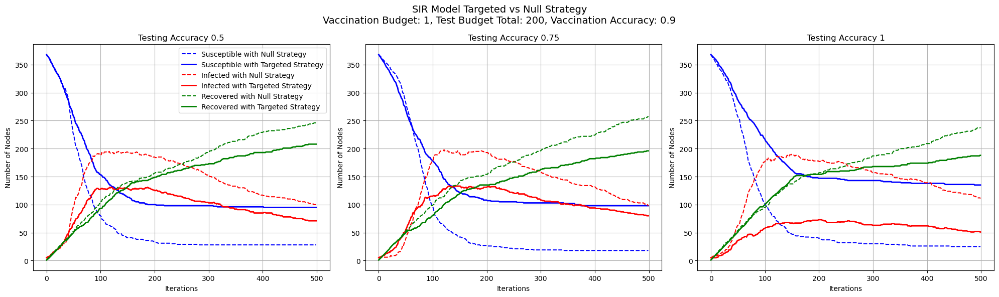

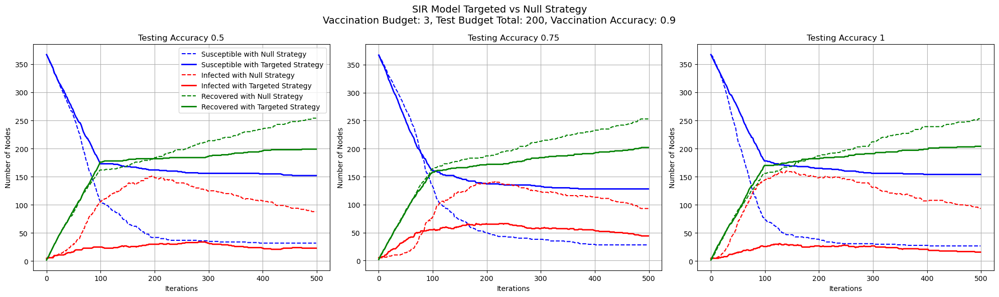

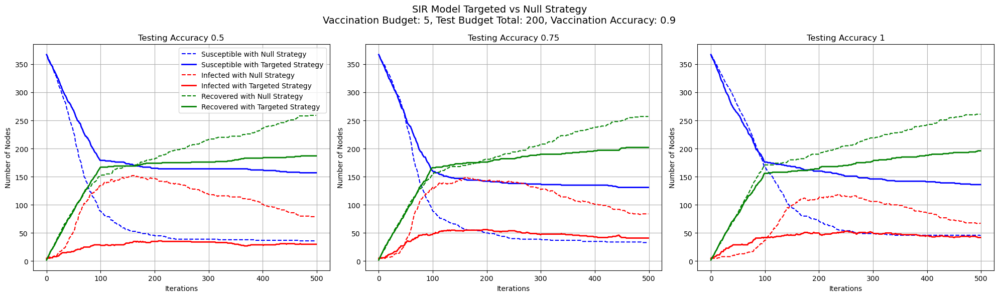

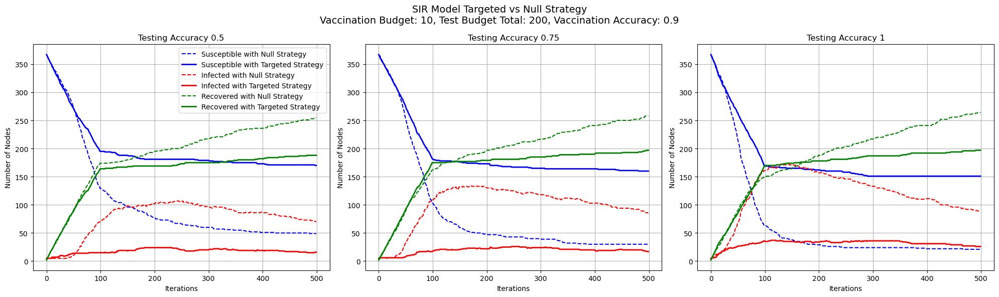

In [63]:
import pandas as pd
import numpy as np

def find_5random_infected(g):
    # Find 5 random nodes to infect
    random_infected = np.random.choice(g.nodes, 5, replace=False)
    return random_infected

   

def create_SIR_vac(g, beta, gamma, initial_infected_nodes, num_iterations, vac_budget, test_budget_total, test_budget_iter, test_acc, vac_acc, strategy=0):
    
    vac_nodes = [] #vaccinated nodes
    inf_nodes = [] #infected nodes
    test_nodes = [] #tested nodes
    total_tests_done = 0 #how many tests were done in total

    #create the model
    model = ep.SIRModel(g)
    config = mc.Configuration()
    config.add_model_parameter('beta', beta)
    config.add_model_parameter('gamma', gamma)
    config.add_model_parameter("fraction_infected", 5/g.number_of_nodes())
    config.add_model_initial_configuration("Infected", initial_infected_nodes)
    model.set_initial_status(config)

    
    if strategy == 1:
        degree_centrality = nx.degree_centrality(g)
        sorted_nodes = sorted(degree_centrality, key=degree_centrality.get, reverse=True)
    else:
        sorted_nodes = list(g.nodes)
        np.random.shuffle(sorted_nodes)

    S_values = []
    I_values = []
    R_values = []

    i = 1

    while i <= num_iterations:
        model.iteration() #run one iteration

        #get untested nodes
        untested_nodes = [node for node in sorted_nodes if node not in test_nodes]
        #set the amount for the vaccinations for this round to the highest possible value(amount of untested nodes or the budget)
        if len(untested_nodes) > vac_budget:
            vac_iter = vac_budget
        else:
            vac_iter = len(untested_nodes)
        
        num_test = 0 #how many tests have been conducted in this iteration
        num_vac = 0 #how many vaccinations we have done in this iteration

        #keep vaccinating while you still have vaccines, untested nodes and tests
        while (num_vac < vac_iter and num_test < test_budget_iter and len(untested_nodes) > 0 and total_tests_done < test_budget_total):
            #perform the test
            node_to_test = untested_nodes[0]
            untested_nodes.remove(node_to_test)
            test_nodes.append(node_to_test)
            num_test += 1
            total_tests_done += 1

            #determine if the node is infected or not
            #it is considered not-infected if the node is in S, R or in I but the test failed
            if(model.status[node_to_test] == 0 or (model.status[node_to_test] == 1 and np.random.rand() > test_acc) or model.status[node_to_test] == 2):
                #vaccinate nodes that are susceptible, recovered
                if (model.status[node_to_test] != 1 and np.random.rand() < vac_acc):
                    vac_nodes.append(node_to_test)
                    num_vac += 1
                    model.status[node_to_test] = 2
                #vaccinate nodes that are infected and test failed, so we basically waste a vaccination on them since they cannot be moved to the reovered state
                elif (model.status[node_to_test] == 1 and np.random.rand() < vac_acc):
                    vac_nodes.append(node_to_test)
                    num_vac += 1
            #infected = node in I and test succeeded
            else:
                inf_nodes.append(node_to_test)

        #store data needed for plotting

        #get total number of S,I,R from this iteration
        S = 0
        I = 0
        R = 0
        for node in g.nodes:
            if model.status[node] == 0 :
                S += 1
            elif model.status[node] == 1:
                I += 1
            else:
               R += 1
        
        S_values.append(S)
        I_values.append(I)
        R_values.append(R)

        i+=1
    return S_values, I_values, R_values
        
def plot_vac_null2(S_null, I_null, R_null, S_str, I_str, R_str, vac_budget, test_budget_total, test_acc, vac_acc):
    #plot
    plt.figure(figsize=(10, 6))
    #plot 3 in a row
    ax, fig = plt.subplots(1, 3, figsize=(20, 6))
    
    plt.plot(S_null, label='Susceptible without Strategy', linestyle='--', color='blue')
    plt.plot(I_null, label='Infected without Strategy', linestyle='--', color='red')
    plt.plot(R_null, label='Recovered without Strategy', linestyle='--', color='green')
    plt.plot(S_str, label='Susceptible with Strategy', color='blue', linewidth=2)
    plt.plot(I_str, label='Infected with Strategy', color='red', linewidth=2)
    plt.plot(R_str, label='Recovered with Strategy', color='green', linewidth=2)
    plt.legend()
    
    # parameters
    title = (f"SIR Model Targeted vs Null Strategy\n"
            f"Vaccination Budget: {vac_budget}, "
            f"Test Budget Total: {test_budget_total}, Test Accuracy: {test_acc}, "
            f"Vaccination Accuracy: {vac_acc}")
    plt.title(title, fontsize=14)
    plt.xlabel("Iterations")
    plt.ylabel("Number of Nodes")
    plt.grid(True)
    plt.show()

def plot_vac_null(S_null, I_null, R_null, S_str, I_str, R_str, vac_budget, test_budget_total, test_acc, vac_acc):
    # Create a figure with 1 row and 3 columns
    fig, axs = plt.subplots(1, 3, figsize=(20, 6))

    axs[0].plot(S_null[0], label = 'Susceptible with Null Strategy', linestyle='--', color='blue')
    axs[0].plot(S_str[0], label = 'Susceptible with Targeted Strategy', color='blue', linewidth=2)
    axs[0].plot(I_null[0], label = 'Infected with Null Strategy', linestyle='--', color='red')
    axs[0].plot(I_str[0], label = 'Infected with Targeted Strategy', color='red', linewidth=2)
    axs[0].plot(R_null[0], label = 'Recovered with Null Strategy' ,linestyle='--', color='green')
    axs[0].plot(R_str[0], label = 'Recovered with Targeted Strategy',color='green', linewidth=2)
    axs[0].set_title(f"Testing Accuracy {test_acc[0]}")
    axs[0].set_xlabel("Iterations")
    axs[0].set_ylabel("Number of Nodes")
    axs[0].grid(True)
    axs[0].legend()

    axs[1].plot(S_null[1], linestyle='--', color='blue')
    axs[1].plot(S_str[1], color='blue', linewidth=2)
    axs[1].plot(I_null[1], linestyle='--', color='red')
    axs[1].plot(I_str[1], color='red', linewidth=2)
    axs[1].plot(R_null[1], linestyle='--', color='green')
    axs[1].plot(R_str[1], color='green', linewidth=2)
    axs[1].set_title(f"Testing Accuracy {test_acc[1]}")
    axs[1].set_xlabel("Iterations")
    axs[1].set_ylabel("Number of Nodes")
    axs[1].grid(True)

    axs[2].plot(S_null[2], linestyle='--', color='blue')
    axs[2].plot(S_str[2], color='blue', linewidth=2)
    axs[2].plot(I_null[2], linestyle='--', color='red')
    axs[2].plot(I_str[2], color='red', linewidth=2)
    axs[2].plot(R_null[2], linestyle='--', color='green')
    axs[2].plot(R_str[2], color='green', linewidth=2)
    axs[2].set_title(f"Testing Accuracy {test_acc[2]}")
    axs[2].set_xlabel("Iterations")
    axs[2].set_ylabel("Number of Nodes")
    axs[2].grid(True)

    # Overall title
    plt.suptitle(f"SIR Model Targeted vs Null Strategy\n"
                 f"Vaccination Budget: {vac_budget}, "
                 f"Test Budget Total: {test_budget_total}, "
                 f"Vaccination Accuracy: {vac_acc}", fontsize=14)

    plt.tight_layout()  # Adjust layout to fit title
    plt.show()


         

# Step 1: Load the CSV file
df = pd.read_csv('transmission_network.csv', index_col=0, delimiter=';')
df = df.map(lambda x: 1 if x != 0 else x)  # Convert all non-zero values to 1



# Create a NetworkX graph from the adjacency matrix
G = nx.from_numpy_array(df.values)

# Print number of nodes and edges
print(f"Number of nodes: {G.number_of_nodes()}")
print(f"Number of edges: {G.number_of_edges()}")

test_acc = [0.5, 0.75, 1]
vac_budget = [1, 3, 5, 10]

total_tests = 200
initial_infected = find_5random_infected(G)




for v_b in vac_budget:
    S_null_list = []
    I_null_list = []
    R_null_list = []
    S_str_list = []
    I_str_list = []
    R_str_list = []
    for t_a in test_acc:
        S_str, I_str, R_str = create_SIR_vac(G, 0.01, 0.002, initial_infected, 500, v_b, total_tests, 2, t_a, 0.9, 1)
        S_null, I_null, R_null = create_SIR_vac(G, 0.01, 0.002, initial_infected, 500, v_b, total_tests, 2, t_a, 0.9)
        S_null_list.append(S_null)
        I_null_list.append(I_null)
        R_null_list.append(R_null)
        S_str_list.append(S_str)
        I_str_list.append(I_str)
        R_str_list.append(R_str)
    plot_vac_null(S_null_list, I_null_list, R_null_list, S_str_list, I_str_list, R_str_list, v_b, total_tests, test_acc, 0.9)



